# Project Team ID : "PTID-CDS-JUL-23-1577"

# Team members
- Dhaya thilak bharathi p (dhayathilak96@gmail.com)
- Jeju (chinthaparthijeju123@gmail.com)

# Project ID: PRCP-1025-FlightPricePrediction

# business case

- To predict the price of flight based on various factors like brand of the flight,distance ,source ,destination and various other factors

## Import basic libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import warnings
warnings.filterwarnings('ignore')

## load the dataset

In [2]:
data = pd.read_excel('Flight_Fare.xlsx')

In [3]:
data.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
0,IndiGo,24/03/2019,Banglore,New Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897
1,Air India,1/05/2019,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2 stops,No info,7662
2,Jet Airways,9/06/2019,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882
3,IndiGo,12/05/2019,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1 stop,No info,6218
4,IndiGo,01/03/2019,Banglore,New Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1 stop,No info,13302


## Domain analysis

- To find the price of airlines according to the given Features

- Airline: The brand or name of the airlines
- Date: The date when the passenger has travelled to the specific destination
- Source: The starting point of the journey
- Destination: The destination to which the passenger has travelled
- Route : The travel route by which the passenger has taken to reach the destination
- Dep_Time: The time at which the flight has departed from the source
- Arrival_Time: The time by which the flight has arrived at the destination
- Duration: Total duration of the travel
- Total_Stops: Determines whether the flight has travelled directly or has one more stops in between
- Additional_Info: Gives information about whether the flight is business class,direct flight, whether to change the airports,meals are included in flight or not
- Price: The target column of the given data to be determined

## basic checks

In [4]:
# number of rows and columns
data.shape

(10683, 11)

In [5]:
# check the columns of the given data
data.columns

Index(['Airline', 'Date_of_Journey', 'Source', 'Destination', 'Route',
       'Dep_Time', 'Arrival_Time', 'Duration', 'Total_Stops',
       'Additional_Info', 'Price'],
      dtype='object')

In [6]:
# to find the memory size of the given data
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10683 entries, 0 to 10682
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Airline          10683 non-null  object
 1   Date_of_Journey  10683 non-null  object
 2   Source           10683 non-null  object
 3   Destination      10683 non-null  object
 4   Route            10682 non-null  object
 5   Dep_Time         10683 non-null  object
 6   Arrival_Time     10683 non-null  object
 7   Duration         10683 non-null  object
 8   Total_Stops      10682 non-null  object
 9   Additional_Info  10683 non-null  object
 10  Price            10683 non-null  int64 
dtypes: int64(1), object(10)
memory usage: 918.2+ KB


- the data is of 918 kb size
- all the columns are in objects

In [7]:
# print the first five rows of the given data
data.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
0,IndiGo,24/03/2019,Banglore,New Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897
1,Air India,1/05/2019,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2 stops,No info,7662
2,Jet Airways,9/06/2019,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882
3,IndiGo,12/05/2019,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1 stop,No info,6218
4,IndiGo,01/03/2019,Banglore,New Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1 stop,No info,13302


In [8]:
# print last five rows of the data
data.tail()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
10678,Air Asia,9/04/2019,Kolkata,Banglore,CCU → BLR,19:55,22:25,2h 30m,non-stop,No info,4107
10679,Air India,27/04/2019,Kolkata,Banglore,CCU → BLR,20:45,23:20,2h 35m,non-stop,No info,4145
10680,Jet Airways,27/04/2019,Banglore,Delhi,BLR → DEL,08:20,11:20,3h,non-stop,No info,7229
10681,Vistara,01/03/2019,Banglore,New Delhi,BLR → DEL,11:30,14:10,2h 40m,non-stop,No info,12648
10682,Air India,9/05/2019,Delhi,Cochin,DEL → GOI → BOM → COK,10:55,19:15,8h 20m,2 stops,No info,11753


In [9]:
#for numerical columns
data.describe()

,Price
count,10683.000000
mean,9087.064121
std,4611.359167
min,1759.000000
25%,5277.000000
50%,8372.000000
75%,12373.000000
max,79512.000000


In [10]:
# statistical information for object columns
data.describe(include='O')

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info
count,10683,10683,10683,10683,10682,10683,10683,10683,10682,10683
unique,12,44,5,6,128,222,1343,368,5,10
top,Jet Airways,18/05/2019,Delhi,Cochin,DEL → BOM → COK,18:55,19:00,2h 50m,1 stop,No info
freq,3849,504,4537,4537,2376,233,423,550,5625,8345


In [11]:
# check for null values
data.isnull().sum()

Airline            0
Date_of_Journey    0
Source             0
Destination        0
Route              1
Dep_Time           0
Arrival_Time       0
Duration           0
Total_Stops        1
Additional_Info    0
Price              0
dtype: int64

- There are null values in Route and Total_Stops columns

In [12]:
#checking the datatypes of the given column
data.dtypes

Airline            object
Date_of_Journey    object
Source             object
Destination        object
Route              object
Dep_Time           object
Arrival_Time       object
Duration           object
Total_Stops        object
Additional_Info    object
Price               int64
dtype: object

In [13]:
#How many flights are there in each airlines
data.Airline.value_counts()

Jet Airways                          3849
IndiGo                               2053
Air India                            1752
Multiple carriers                    1196
SpiceJet                              818
Vistara                               479
Air Asia                              319
GoAir                                 194
Multiple carriers Premium economy      13
Jet Airways Business                    6
Vistara Premium economy                 3
Trujet                                  1
Name: Airline, dtype: int64

In [14]:
#how many people travelled on the particular date
data.Date_of_Journey.value_counts()

18/05/2019    504
6/06/2019     503
21/05/2019    497
9/06/2019     495
12/06/2019    493
9/05/2019     484
21/03/2019    423
15/05/2019    405
27/05/2019    382
27/06/2019    355
24/06/2019    351
1/06/2019     342
3/06/2019     333
15/06/2019    328
24/03/2019    323
6/03/2019     308
27/03/2019    299
24/05/2019    286
6/05/2019     282
1/05/2019     277
12/05/2019    259
1/04/2019     257
3/03/2019     218
9/03/2019     200
15/03/2019    162
18/03/2019    156
01/03/2019    152
12/03/2019    142
9/04/2019     125
3/04/2019     110
21/06/2019    109
18/06/2019    105
09/03/2019    102
6/04/2019     100
03/03/2019     97
06/03/2019     95
27/04/2019     94
24/04/2019     92
3/05/2019      90
15/04/2019     89
21/04/2019     82
18/04/2019     67
12/04/2019     63
1/03/2019      47
Name: Date_of_Journey, dtype: int64

In [15]:
#How many flights have travelled from each source
data.Source.value_counts()

Delhi       4537
Kolkata     2871
Banglore    2197
Mumbai       697
Chennai      381
Name: Source, dtype: int64

In [16]:
#How many flights have arrived at each destination
data.Destination.value_counts()

Cochin       4537
Banglore     2871
Delhi        1265
New Delhi     932
Hyderabad     697
Kolkata       381
Name: Destination, dtype: int64

In [17]:
# check how many flights are there in each route
data.Route.value_counts(pd.set_option("display.max_rows", None))

DEL → BOM → COK                      2376
BLR → DEL                            1552
CCU → BOM → BLR                       979
CCU → BLR                             724
BOM → HYD                             621
CCU → DEL → BLR                       565
BLR → BOM → DEL                       402
MAA → CCU                             381
DEL → HYD → COK                       326
DEL → JAI → BOM → COK                 240
DEL → BLR → COK                       232
DEL → COK                             213
DEL → AMD → BOM → COK                 205
DEL → MAA → COK                       146
DEL → IDR → BOM → COK                  99
DEL → HYD → MAA → COK                  83
DEL → NAG → BOM → COK                  71
CCU → MAA → BLR                        65
DEL → GOI → BOM → COK                  58
DEL → HYD → BOM → COK                  56
CCU → HYD → BLR                        53
CCU → BBI → BLR                        50
DEL → BHO → BOM → COK                  50
CCU → IXR → DEL → BLR             

In [18]:
# no of times the flight has travelled in particular route
data.Route.value_counts(pd.set_option("display.max_rows", None)).sort_values()

BOM → BBI → HYD                         1
BOM → RPR → VTZ → HYD                   1
BLR → CCU → BBI → HYD → VGA → DEL       1
BLR → BOM → IXC → DEL                   1
BLR → HBX → BOM → NAG → DEL             1
BOM → VNS → DEL → HYD                   1
BOM → JAI → DEL → HYD                   1
CCU → IXB → DEL → BLR                   1
BOM → GOI → HYD                         1
BOM → DED → DEL → HYD                   1
BLR → HBX → BOM → AMD → DEL             1
BOM → CCU → HYD                         1
CCU → IXA → BLR                         1
BOM → NDC → HYD                         1
BOM → UDR → DEL → HYD                   1
BOM → JLR → HYD                         1
BOM → JDH → JAI → DEL → HYD             1
BOM → BLR → CCU → BBI → HYD             1
CCU → RPR → HYD → BLR                   1
CCU → VTZ → BLR                         1
CCU → IXZ → MAA → BLR                   1
BOM → COK → MAA → HYD                   1
BLR → HBX → BOM → BHO → DEL             1
BLR → STV → DEL                   

In [19]:
# How many times the flight has arrived at the specific departure time
data.Dep_Time.value_counts(pd.set_option("display.max_rows", None))

18:55    233
17:00    227
07:05    205
10:00    203
07:10    202
20:00    185
09:00    184
09:35    183
21:10    180
07:00    167
13:00    164
14:05    163
11:40    161
10:20    159
11:30    158
08:00    152
09:45    140
06:30    140
05:30    138
08:25    136
06:00    131
20:25    125
05:45    122
17:45    118
22:50    114
08:20    114
16:30    109
16:55    109
16:00    100
12:00     98
19:45     97
07:30     95
19:35     94
15:15     91
09:40     90
17:30     90
17:15     89
09:25     85
19:30     83
02:15     80
20:20     79
20:55     78
05:55     78
05:50     78
13:15     76
08:45     75
21:25     74
04:55     73
15:00     72
07:35     72
11:10     71
06:40     71
14:00     71
06:50     70
22:20     70
08:30     69
09:30     68
23:05     66
18:15     66
06:55     66
21:50     66
10:35     63
17:10     63
16:45     62
21:05     61
19:00     59
07:55     59
14:35     58
09:10     57
14:25     56
05:15     56
23:30     55
13:20     53
19:10     53
06:05     53
08:55     52
19:15     51

In [20]:
# how many times the flight has arrived at the particular time
data.Arrival_Time.value_counts()

19:00           423
21:00           360
19:15           333
16:10           154
12:35           122
20:45           112
18:50           111
22:30           111
22:50           104
11:20            95
19:50            94
21:20            90
12:20            87
22:25            77
21:05            72
23:35            71
20:05            69
14:05            68
08:35            67
12:00            63
19:45            60
23:00            57
07:15            56
12:55            55
13:15            54
18:10            54
11:25            54
15:30            53
10:40            53
08:45            53
19:40            53
22:00            52
10:10            51
22:35            51
19:35            50
22:55            50
16:20            49
10:05            49
12:10            49
11:50            49
18:15            49
21:50            49
13:55            49
07:45            49
09:30            49
04:25 07 Jun     48
10:35            48
08:50            48
23:15            46
22:20            45


In [21]:
# how many times the flight has travelled for a particular duration
data.Duration.value_counts()

2h 50m     550
1h 30m     386
2h 45m     337
2h 55m     337
2h 35m     329
3h         261
2h 20m     238
2h 30m     220
2h 40m     158
1h 25m     135
2h 15m     135
2h 25m      98
13h 30m     97
13h 20m     89
3h 15m      88
7h 30m      86
9h 30m      85
8h 40m      81
7h 15m      79
3h 5m       78
5h 30m      72
7h 35m      71
8h          68
7h 5m       65
9h          64
9h 50m      64
5h          63
11h 45m     62
11h         62
5h 15m      62
1h 20m      61
14h 25m     61
6h 35m      60
10h 30m     57
22h 55m     57
12h 10m     57
12h 45m     56
5h 45m      54
16h 5m      53
11h 30m     52
7h 20m      52
12h 30m     52
4h 55m      51
15h 10m     51
8h 25m      50
10h 15m     50
12h         49
10h         49
10h 25m     49
12h 15m     48
6h 15m      47
11h 5m      45
5h 20m      45
26h 55m     44
9h 15m      42
14h 5m      42
13h         42
8h 55m      42
9h 20m      41
20h 10m     41
9h 35m      41
3h 10m      40
17h 5m      40
23h 40m     40
21h 15m     39
26h 35m     39
27h 35m   

In [22]:
# how many times the flight has stopped at a particular spot
data.Total_Stops.value_counts()

1 stop      5625
non-stop    3491
2 stops     1520
3 stops       45
4 stops        1
Name: Total_Stops, dtype: int64

In [23]:
# counts of additional information about the flights
data.Additional_Info.value_counts()

No info                         8345
In-flight meal not included     1982
No check-in baggage included     320
1 Long layover                    19
Change airports                    7
Business class                     4
No Info                            3
1 Short layover                    1
Red-eye flight                     1
2 Long layover                     1
Name: Additional_Info, dtype: int64

In [24]:
# how many times the price has been predicted by the model
data.Price.value_counts()

10262    258
10844    212
7229     162
4804     160
4823     131
14714    109
3943     104
15129     93
3841      91
12898     86
3597      86
9663      84
14781     84
3873      80
12373     77
14151     74
8586      70
4174      69
5678      65
10368     63
8016      60
6442      60
3100      58
14571     57
13941     57
11087     57
13014     57
2754      56
4423      53
4544      51
4668      49
13377     49
14388     49
7832      47
3543      45
8372      43
3419      43
13587     42
13067     42
7480      41
2227      40
7064      40
13376     39
8040      39
9646      38
4049      38
6961      37
15554     36
1965      36
13292     36
16079     36
4995      35
2017      35
13817     35
4878      34
13029     33
5228      32
4148      32
3383      31
14871     31
6093      30
12692     30
11467     29
4409      29
5403      29
4030      29
4591      29
3625      29
5192      28
8452      28
6795      27
6144      27
8610      27
13727     26
7408      26
8529      26
6216      25

## Exploratory data analysis

### univariate 

In [25]:
# univariate
fig = plt.figure(figsize=(100,100),facecolor='white')
plotnumber=1
for columns in data:
    if plotnumber<=11:
        ax = plt.subplot(4,3,plotnumber)
        sns.histplot(x=data[columns],kde=True)
        plt.xlabel(columns,fontsize=40)
        plt.ylabel('price',fontsize=40)
    plotnumber+=1
plt.tight_layout()

- the given data does not follow normal distribution

### bivariate

<AxesSubplot:xlabel='Price', ylabel='Airline'>

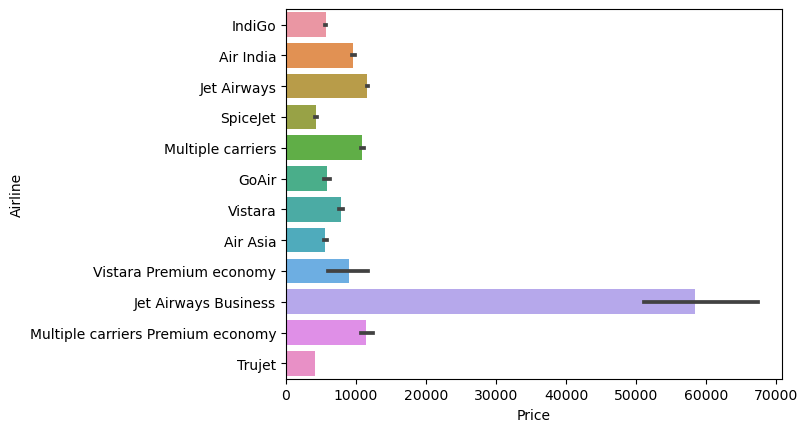

In [26]:
# comparison of airlinename with price column
sns.barplot(x='Price',y='Airline',data=data)

- the most expensive flight is jet airways business
- the least expensive flight is Trujet and SpiceJet

<AxesSubplot:xlabel='Source', ylabel='Price'>

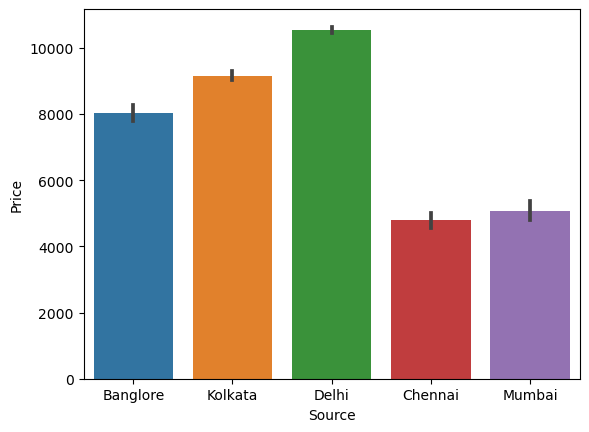

In [27]:
# comparison with source and price
sns.barplot(x='Source',y='Price',data=data)

- the most expensive routes are Delhi,Kolkata and Banglore
- The least expensive route is Chennai and Mumbai

<AxesSubplot:xlabel='Destination', ylabel='Price'>

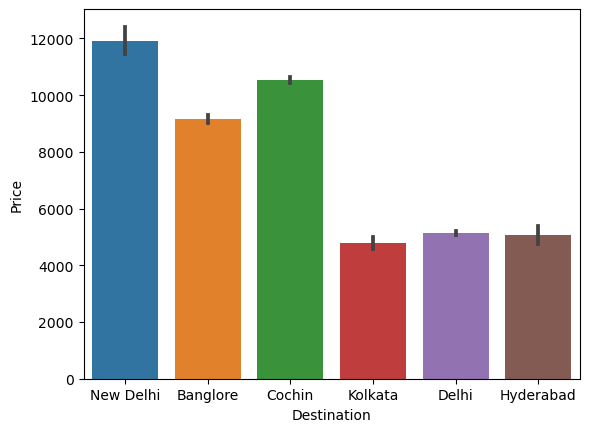

In [28]:
# comparison  destination and price
sns.barplot(x='Destination',y='Price',data=data)

- The most expensive Destinations for air travel are New delhi,Banglore and Kolkata
- the cheapest destinations for air travel are  Kolkata,delhi and hyderbad

<AxesSubplot:xlabel='count', ylabel='Route'>

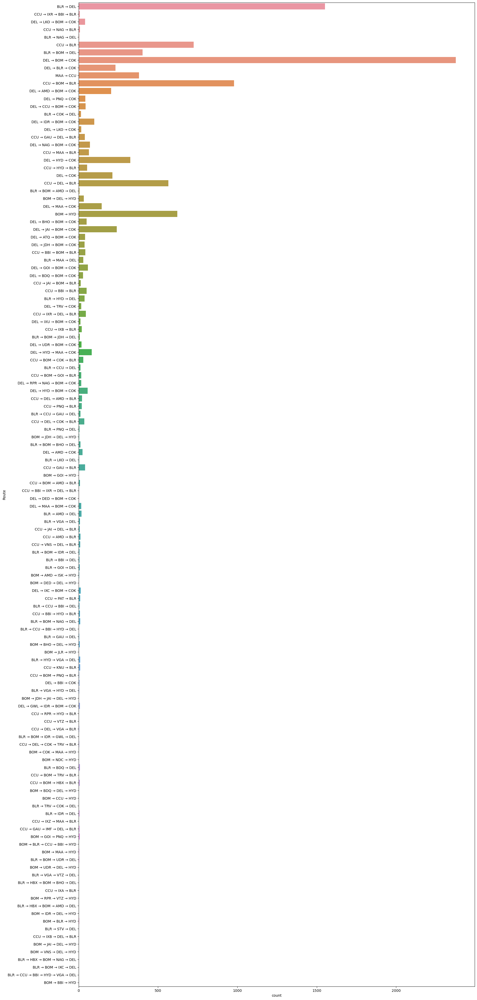

In [29]:
# comparison of Route and Price
plt.figure(figsize=(20,50))
sns.countplot(y='Route',data=data)

- Most people travelled a round trip to reach their destination 
- The most travelled route is Delhi-bombay-Cochin

## multivariate

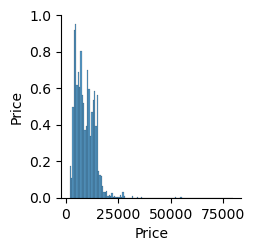

In [30]:
sns.pairplot(data)

In [31]:
data.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
0,IndiGo,24/03/2019,Banglore,New Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897
1,Air India,1/05/2019,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2 stops,No info,7662
2,Jet Airways,9/06/2019,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882
3,IndiGo,12/05/2019,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1 stop,No info,6218
4,IndiGo,01/03/2019,Banglore,New Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1 stop,No info,13302


## Data preprocessing

In [32]:
#check for null values
data.isnull().sum()

Airline            0
Date_of_Journey    0
Source             0
Destination        0
Route              1
Dep_Time           0
Arrival_Time       0
Duration           0
Total_Stops        1
Additional_Info    0
Price              0
dtype: int64

In [33]:
# checking route column for null values
data.loc[data.Route.isnull()]

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
9039,Air India,6/05/2019,Delhi,Cochin,NaN,09:45,09:25 07 May,23h 40m,NaN,No info,7480


In [34]:
# checking for total_stops column for null values
data.loc[data.Total_Stops.isnull()]

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
9039,Air India,6/05/2019,Delhi,Cochin,NaN,09:45,09:25 07 May,23h 40m,NaN,No info,7480


In [35]:
data.loc[data.Route.isnull()]

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
9039,Air India,6/05/2019,Delhi,Cochin,NaN,09:45,09:25 07 May,23h 40m,NaN,No info,7480


In [36]:
# handling rows with null values
data.dropna(inplace=True)

In [37]:
data.loc[data.Route.isnull()]

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price


In [38]:
data.loc[data.Total_Stops.isnull()]

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price


### Conversion of object columns to numeric

In [39]:
data.Date_of_Journey.dtype

dtype('O')

In [40]:
data.Date_of_Journey =pd.to_datetime(data.Date_of_Journey)

In [41]:
data['month'] = data.Date_of_Journey.dt.month

In [42]:
data['year']= data.Date_of_Journey.dt.year

In [43]:
data['day']= data.Date_of_Journey.dt.day

In [44]:
data.drop('Date_of_Journey',inplace=True,axis=1)

In [45]:
data.Dep_Time= pd.to_datetime(data.Dep_Time)

In [46]:
data['dep_hour']= data.Dep_Time.dt.hour
data['dep_minute']= data.Dep_Time.dt.minute
data['dep_second']= data.Dep_Time.dt.second

In [47]:
data.drop('Dep_Time',inplace=True,axis=1)

In [48]:
data.head()

,Airline,Source,Destination,Route,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,month,year,day,dep_hour,dep_minute,dep_second
0,IndiGo,Banglore,New Delhi,BLR → DEL,01:10 22 Mar,2h 50m,non-stop,No info,3897,3,2019,24,22,20,0
1,Air India,Kolkata,Banglore,CCU → IXR → BBI → BLR,13:15,7h 25m,2 stops,No info,7662,1,2019,5,5,50,0
2,Jet Airways,Delhi,Cochin,DEL → LKO → BOM → COK,04:25 10 Jun,19h,2 stops,No info,13882,9,2019,6,9,25,0
3,IndiGo,Kolkata,Banglore,CCU → NAG → BLR,23:30,5h 25m,1 stop,No info,6218,12,2019,5,18,5,0
4,IndiGo,Banglore,New Delhi,BLR → NAG → DEL,21:35,4h 45m,1 stop,No info,13302,1,2019,3,16,50,0


In [49]:
data.Arrival_Time= pd.to_datetime(data.Arrival_Time)

In [50]:
data['Arrival_Time_hour']= data.Arrival_Time.dt.hour
data['Arrival_Time_minute']= data.Arrival_Time.dt.minute
data['Arrival_Time_second']= data.Arrival_Time.dt.second

In [51]:
data.drop('Arrival_Time',inplace=True,axis=1)

In [52]:
data.Duration=pd.to_timedelta(data.Duration)

In [53]:
data['Duration_hours']= data.Duration.dt.components['hours']
data['Duration_minutes']= data.Duration.dt.components['minutes']

In [54]:
data.drop('Duration',inplace=True,axis=1)

In [55]:
data.head()

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,month,year,day,dep_hour,dep_minute,dep_second,Arrival_Time_hour,Arrival_Time_minute,Arrival_Time_second,Duration_hours,Duration_minutes
0,IndiGo,Banglore,New Delhi,BLR → DEL,non-stop,No info,3897,3,2019,24,22,20,0,1,10,0,2,50
1,Air India,Kolkata,Banglore,CCU → IXR → BBI → BLR,2 stops,No info,7662,1,2019,5,5,50,0,13,15,0,7,25
2,Jet Airways,Delhi,Cochin,DEL → LKO → BOM → COK,2 stops,No info,13882,9,2019,6,9,25,0,4,25,0,19,0
3,IndiGo,Kolkata,Banglore,CCU → NAG → BLR,1 stop,No info,6218,12,2019,5,18,5,0,23,30,0,5,25
4,IndiGo,Banglore,New Delhi,BLR → NAG → DEL,1 stop,No info,13302,1,2019,3,16,50,0,21,35,0,4,45


In [56]:
# check for unique values for airline column
data.Airline.unique()

array(['IndiGo', 'Air India', 'Jet Airways', 'SpiceJet',
       'Multiple carriers', 'GoAir', 'Vistara', 'Air Asia',
       'Vistara Premium economy', 'Jet Airways Business',
       'Multiple carriers Premium economy', 'Trujet'], dtype=object)

### We are doing manual encoding for the column Airline

In [57]:
data['Airline']=data['Airline'].map({'IndiGo':1, 'Air India':2, 'Jet Airways':3, 'SpiceJet':4,
       'Multiple carriers':5, 'GoAir':6, 'Vistara':7, 'Air Asia':8,
       'Vistara Premium economy': 9, 'Jet Airways Business':10,
       'Multiple carriers Premium economy':11, 'Trujet':12})

- 1- 'IndiGo'
- 2- 'Air India' 
- 3- 'Jet Airways'
- 4- 'SpiceJet'
- 5- 'Multiple carriers'
- 6- 'GoAir'
- 7- 'Vistara'
- 8- 'Air Asia'
- 9- 'Vistara Premium economy'
- 10- 'Jet Airways Business'
- 11- 'Multiple carriers Premium economy'
- 12- 'Trujet'


In [58]:
# check for unique values in Source column
data.Source.unique()

array(['Banglore', 'Kolkata', 'Delhi', 'Chennai', 'Mumbai'], dtype=object)

### We are doing manual encoding for the column Source

In [59]:
data['Source']= data['Source'].map({'Banglore': 1, 'Kolkata': 2, 'Delhi': 3, 'Chennai': 4, 'Mumbai': 5})

- 1- 'Banglore', 
- 2-'Kolkata', 
- 3-'Delhi', 
- 4-'Chennai', 
- 5-'Mumbai'

In [60]:
#check for unique values in destination column
data.Destination.unique()

array(['New Delhi', 'Banglore', 'Cochin', 'Kolkata', 'Delhi', 'Hyderabad'],
      dtype=object)

### Manual encoding for column Destination

In [61]:
data['Destination']= data['Destination'].map({'New Delhi': 1,'Banglore': 2, 'Cochin': 3, 'Kolkata': 4, 
                                              'Delhi': 5,'Hyderabad': 6})

- 1-'New Delhi'
- 2-'Banglore'
- 3-'Cochin'
- 4- 'Kolkata'
- 5- 'Delhi'
- 6- 'Hyderabad'

In [62]:
#check for unique values in Total_Stops column
data.Total_Stops.unique()

array(['non-stop', '2 stops', '1 stop', '3 stops', '4 stops'],
      dtype=object)

In [63]:
data['Total_Stops']=data['Total_Stops'].map({'non-stop':1, '2 stops':2, '1 stop':3, '3 stops':4, '4 stops':5})

- 1- 'non-stop'
- 2- '2 stops' 
- 3- '1 stop'
- 4- '3 stops'
- 5- '4 stops'

In [64]:
# check for unique values in Additional_Info column
data.Additional_Info.unique()

array(['No info', 'In-flight meal not included',
       'No check-in baggage included', '1 Short layover', 'No Info',
       '1 Long layover', 'Change airports', 'Business class',
       'Red-eye flight', '2 Long layover'], dtype=object)

In [65]:
data['Additional_Info']=data['Additional_Info'].map({'No info': 1, 'In-flight meal not included': 2,
       'No check-in baggage included': 3, '1 Short layover': 4, 'No Info': 5,
       '1 Long layover': 6, 'Change airports': 7, 'Business class': 8,
       'Red-eye flight': 9, '2 Long layover': 10})

- 1- 'No info' 
- 2- 'In-flight meal not included' 
- 3- 'No check-in baggage included' 
- 4-'1 Short layover' 
- 5-'No Info'
- 6-'1 Long layover' 
- 7- 'Change airports' 
- 8-'Business class'
- 9-'Red-eye flight'
- 10-'2 Long layover'

In [66]:
data.Route.unique()

array(['BLR → DEL', 'CCU → IXR → BBI → BLR', 'DEL → LKO → BOM → COK',
       'CCU → NAG → BLR', 'BLR → NAG → DEL', 'CCU → BLR',
       'BLR → BOM → DEL', 'DEL → BOM → COK', 'DEL → BLR → COK',
       'MAA → CCU', 'CCU → BOM → BLR', 'DEL → AMD → BOM → COK',
       'DEL → PNQ → COK', 'DEL → CCU → BOM → COK', 'BLR → COK → DEL',
       'DEL → IDR → BOM → COK', 'DEL → LKO → COK',
       'CCU → GAU → DEL → BLR', 'DEL → NAG → BOM → COK',
       'CCU → MAA → BLR', 'DEL → HYD → COK', 'CCU → HYD → BLR',
       'DEL → COK', 'CCU → DEL → BLR', 'BLR → BOM → AMD → DEL',
       'BOM → DEL → HYD', 'DEL → MAA → COK', 'BOM → HYD',
       'DEL → BHO → BOM → COK', 'DEL → JAI → BOM → COK',
       'DEL → ATQ → BOM → COK', 'DEL → JDH → BOM → COK',
       'CCU → BBI → BOM → BLR', 'BLR → MAA → DEL',
       'DEL → GOI → BOM → COK', 'DEL → BDQ → BOM → COK',
       'CCU → JAI → BOM → BLR', 'CCU → BBI → BLR', 'BLR → HYD → DEL',
       'DEL → TRV → COK', 'CCU → IXR → DEL → BLR',
       'DEL → IXU → BOM → COK', 'CCU 

In [67]:
data.Route.nunique()

128

#### Label encoding for column route as the column has 128 values

In [68]:
from sklearn.preprocessing import LabelEncoder

In [69]:
encoder = LabelEncoder()

In [70]:
data['Route']= encoder.fit_transform(data['Route'])

In [71]:
data.head()

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,month,year,day,dep_hour,dep_minute,dep_second,Arrival_Time_hour,Arrival_Time_minute,Arrival_Time_second,Duration_hours,Duration_minutes
0,1,1,1,18,1,1,3897,3,2019,24,22,20,0,1,10,0,2,50
1,2,2,2,84,2,1,7662,1,2019,5,5,50,0,13,15,0,7,25
2,3,3,3,118,2,1,13882,9,2019,6,9,25,0,4,25,0,19,0
3,1,2,2,91,3,1,6218,12,2019,5,18,5,0,23,30,0,5,25
4,1,1,1,29,3,1,13302,1,2019,3,16,50,0,21,35,0,4,45


In [72]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Airline,10682.0,3.151563,1.784673,1.0,2.0,3.0,4.0,12.0
Source,10682.0,2.486051,1.060232,1.0,2.0,3.0,3.0,5.0
Destination,10682.0,3.024995,1.309166,1.0,2.0,3.0,3.0,6.0
Route,10682.0,74.820165,36.729039,0.0,48.0,73.0,104.0,127.0
Total_Stops,10682.0,2.208482,0.909783,1.0,1.0,3.0,3.0,5.0
Additional_Info,10682.0,1.263902,0.584019,1.0,1.0,1.0,1.0,10.0
Price,10682.0,9087.214567,4611.548810,1759.0,5277.0,8372.0,12373.0,79512.0
month,10682.0,5.534731,2.987626,1.0,3.0,5.0,6.0,12.0
year,10682.0,2019.000000,0.000000,2019.0,2019.0,2019.0,2019.0,2019.0
day,10682.0,12.682925,8.803800,3.0,5.0,6.0,21.0,27.0


In [73]:
data.year.value_counts()

2019    10682
Name: year, dtype: int64

#### we drop the year column as the column is has 0 standard deviation

In [74]:
data.drop('year',axis=1,inplace=True)

In [75]:
data.Arrival_Time_second.value_counts()

0    10682
Name: Arrival_Time_second, dtype: int64

In [76]:
data.dep_second.value_counts()

0    10682
Name: dep_second, dtype: int64

#### we drop the arrival_time and dep_second columns as they 0 standard deviation

In [77]:
data.drop(['Arrival_Time_second','dep_second'],axis=1,inplace=True)

In [78]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Airline,10682.0,3.151563,1.784673,1.0,2.0,3.0,4.0,12.0
Source,10682.0,2.486051,1.060232,1.0,2.0,3.0,3.0,5.0
Destination,10682.0,3.024995,1.309166,1.0,2.0,3.0,3.0,6.0
Route,10682.0,74.820165,36.729039,0.0,48.0,73.0,104.0,127.0
Total_Stops,10682.0,2.208482,0.909783,1.0,1.0,3.0,3.0,5.0
Additional_Info,10682.0,1.263902,0.584019,1.0,1.0,1.0,1.0,10.0
Price,10682.0,9087.214567,4611.548810,1759.0,5277.0,8372.0,12373.0,79512.0
month,10682.0,5.534731,2.987626,1.0,3.0,5.0,6.0,12.0
day,10682.0,12.682925,8.803800,3.0,5.0,6.0,21.0,27.0
dep_hour,10682.0,12.491013,5.748820,0.0,8.0,11.0,18.0,23.0


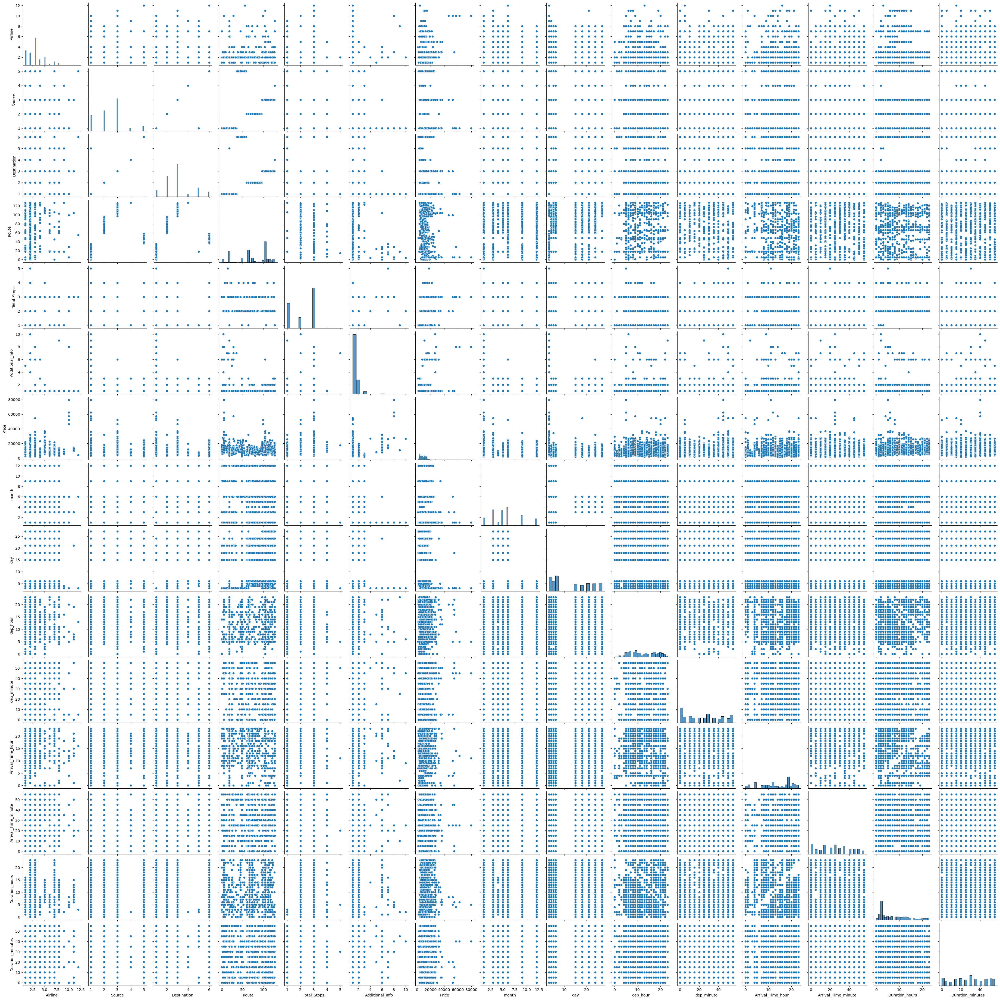

In [79]:
#multivariate
sns.pairplot(data)

## check for missing values

In [80]:
data.isnull().sum()

Airline                0
Source                 0
Destination            0
Route                  0
Total_Stops            0
Additional_Info        0
Price                  0
month                  0
day                    0
dep_hour               0
dep_minute             0
Arrival_Time_hour      0
Arrival_Time_minute    0
Duration_hours         0
Duration_minutes       0
dtype: int64

- there are no null or missing values in the given data

## Check for duplicate values

In [81]:
data.duplicated().sum()

223

In [82]:
data[data.duplicated()]

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,month,day,dep_hour,dep_minute,Arrival_Time_hour,Arrival_Time_minute,Duration_hours,Duration_minutes
683,3,3,3,122,2,1,13376,1,6,14,35,4,25,13,50
1061,2,3,3,108,2,1,10231,5,21,22,0,19,15,21,15
1348,2,3,3,110,2,1,12392,5,18,17,15,19,15,2,0
1418,3,3,3,116,2,2,10368,6,6,5,30,4,25,22,55
1674,1,1,1,18,1,1,7303,3,24,18,25,21,20,2,55
1685,3,3,3,97,2,1,15129,9,5,23,5,12,35,13,30
1704,1,1,1,18,1,1,6860,9,3,18,25,21,20,2,55
1807,3,3,3,122,2,2,10919,1,6,6,45,4,25,21,40
1891,3,3,3,116,2,2,10368,1,6,9,40,12,35,2,55
1971,3,3,3,97,2,1,15129,9,5,23,5,4,25,5,20


- There are no duplicate values in the given data

## Check for Outliers

<AxesSubplot:xlabel='Airline'>

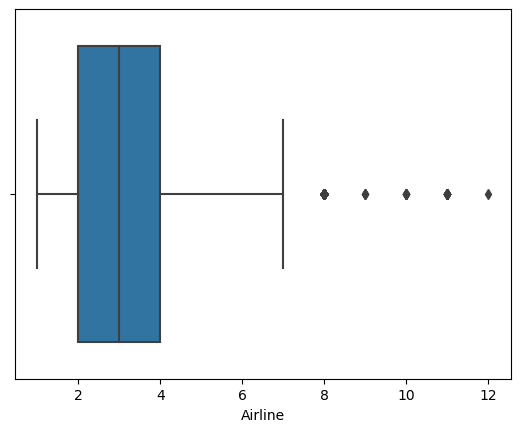

In [83]:
sns.boxplot(x= data['Airline'],data=data)

<AxesSubplot:ylabel='Density'>

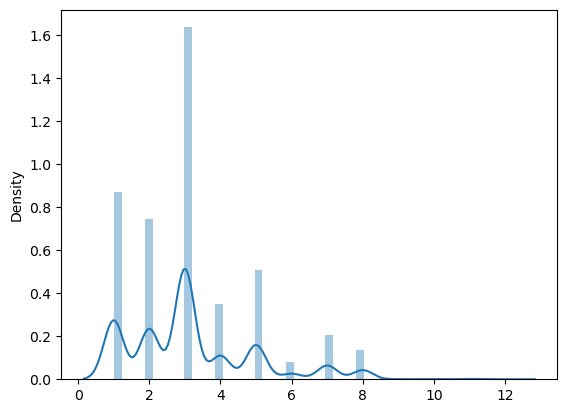

In [84]:
sns.distplot(x=data['Airline'],kde=True)

- The given column does not follow normal distribution

In [85]:
# We replace the outliers in Airline column with IQR
Q1 = data['Airline'].quantile(0.25)
print('Q1: ',Q1)
Q3 = data['Airline'].quantile(0.75)
print('Q3: ',Q3)
IQR = Q3-Q1
print('IQR :',IQR)
lower_limit = Q1-1.5*IQR
print('lower_limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('upper_limit: ',upper_limit)

Q1:  2.0
Q3:  4.0
IQR : 2.0
lower_limit:  -1.0
upper_limit:  7.0


In [86]:
data.loc[data['Airline']<lower_limit]

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,month,day,dep_hour,dep_minute,Arrival_Time_hour,Arrival_Time_minute,Duration_hours,Duration_minutes


In [87]:
data.loc[data['Airline']>upper_limit]

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,month,day,dep_hour,dep_minute,Arrival_Time_hour,Arrival_Time_minute,Duration_hours,Duration_minutes
43,8,1,5,18,1,1,3383,6,5,11,10,13,55,2,45
54,8,1,5,18,1,1,4483,3,4,23,55,2,45,2,50
189,8,1,5,18,1,1,3383,12,6,11,10,13,55,2,45
235,8,2,2,64,1,1,4409,1,5,10,20,12,55,2,35
302,8,2,2,64,1,1,5216,12,5,10,20,12,55,2,35
335,8,2,2,73,3,1,5192,6,5,7,35,23,30,15,55
357,8,3,3,103,3,1,6151,3,21,20,10,7,10,11,0
368,8,2,2,60,3,1,5162,9,4,6,50,10,30,3,40
371,8,2,2,73,3,1,5192,5,24,7,35,19,25,11,50
391,8,3,3,103,3,1,6751,9,5,7,55,13,25,5,30


In [88]:
data.loc[data['Airline']>upper_limit].shape

(342, 15)

In [89]:
data.shape

(10682, 15)

In [90]:
(342/10682)*100

3.2016476315296765

In [91]:
# the ouliers are less than 5% hence we impute the outlier values with median
data.loc[data['Airline']>upper_limit,'Airline']=data['Airline'].median()

In [92]:
# outliers handled in airlines column
data.loc[data['Airline']>upper_limit]

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,month,day,dep_hour,dep_minute,Arrival_Time_hour,Arrival_Time_minute,Duration_hours,Duration_minutes


## Source

<AxesSubplot:xlabel='Source'>

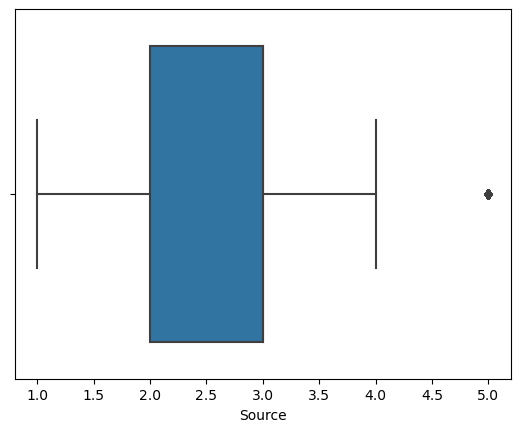

In [93]:
sns.boxplot(x=data['Source'])

<AxesSubplot:ylabel='Density'>

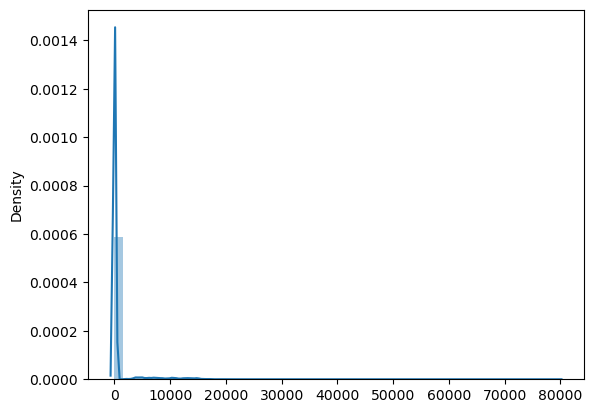

In [94]:
sns.distplot(x=data,kde=True)

In [95]:
# We replace the outliers in Airline column with IQR
Q1 = data['Source'].quantile(0.25)
print('Q1: ',Q1)
Q3 = data['Source'].quantile(0.75)
print('Q3: ',Q3)
IQR = Q3-Q1
print('IQR :',IQR)
lower_limit = Q1-1.5*IQR
print('lower_limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('upper_limit: ',upper_limit)

Q1:  2.0
Q3:  3.0
IQR : 1.0
lower_limit:  0.5
upper_limit:  4.5


In [96]:
data.loc[data['Source']<lower_limit]

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,month,day,dep_hour,dep_minute,Arrival_Time_hour,Arrival_Time_minute,Duration_hours,Duration_minutes


In [97]:
data.loc[data['Source']>upper_limit]

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,month,day,dep_hour,dep_minute,Arrival_Time_hour,Arrival_Time_minute,Duration_hours,Duration_minutes
59,7,5,6,45,3,1,12395,6,3,15,40,16,45,1,5
67,2,5,6,48,1,1,3625,6,5,13,55,15,25,1,30
70,3,5,6,48,1,1,5678,1,6,7,5,8,30,1,25
77,1,5,6,48,1,1,4049,3,4,6,25,7,55,1,30
98,3,5,6,48,1,1,8040,6,18,7,5,8,30,1,25
121,2,5,6,48,1,1,3100,3,5,15,0,16,25,1,25
166,2,5,6,48,1,1,6092,3,3,13,55,15,25,1,30
181,3,5,6,48,1,1,5678,3,27,19,35,21,5,1,30
215,3,5,6,48,1,2,4995,6,24,8,45,10,15,1,30
222,3,5,6,48,1,2,4995,3,18,7,10,8,35,1,25


In [98]:
data.loc[data['Source']>upper_limit].shape

(697, 15)

In [99]:
(697/10682)*100

6.5249953192286085

In [100]:
# the outlier is greater than 5% for the column Source hence we do not impute the values

## Destination

<AxesSubplot:xlabel='Destination'>

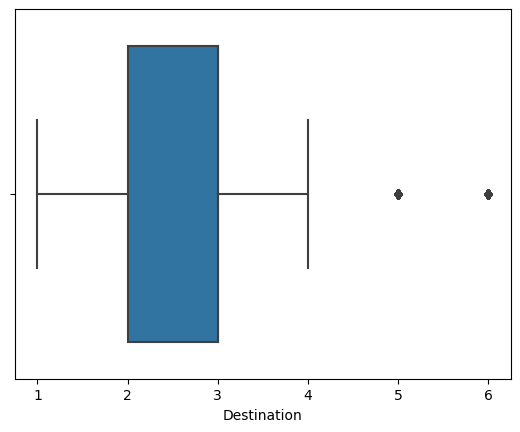

In [101]:
sns.boxplot(x=data['Destination'])

<AxesSubplot:xlabel='Destination', ylabel='Count'>

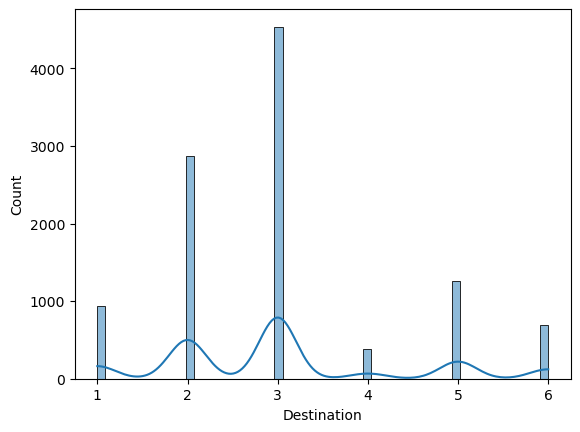

In [102]:
sns.histplot(x=data['Destination'],kde=True)

In [103]:
# We replace the outliers in Destination column with IQR
Q1 = data['Destination'].quantile(0.25)
print('Q1: ',Q1)
Q3 = data['Destination'].quantile(0.75)
print('Q3: ',Q3)
IQR = Q3-Q1
print('IQR :',IQR)
lower_limit = Q1-1.5*IQR
print('lower_limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('upper_limit: ',upper_limit)

Q1:  2.0
Q3:  3.0
IQR : 1.0
lower_limit:  0.5
upper_limit:  4.5


In [104]:
data.loc[data['Destination']<lower_limit]

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,month,day,dep_hour,dep_minute,Arrival_Time_hour,Arrival_Time_minute,Duration_hours,Duration_minutes


In [105]:
data.loc[data['Destination']>upper_limit]

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,month,day,dep_hour,dep_minute,Arrival_Time_hour,Arrival_Time_minute,Duration_hours,Duration_minutes
22,1,1,5,18,1,1,3943,3,4,4,0,6,50,2,50
23,1,1,5,18,1,1,4823,1,5,18,55,21,50,2,55
28,7,1,5,18,1,1,4668,6,18,9,45,12,35,2,50
32,1,1,5,18,1,1,4423,6,4,4,0,6,50,2,50
43,3,1,5,18,1,1,3383,6,5,11,10,13,55,2,45
46,1,1,5,18,1,1,3943,5,27,4,0,6,50,2,50
53,1,1,5,18,1,1,3943,6,18,21,15,0,15,3,0
54,3,1,5,18,1,1,4483,3,4,23,55,2,45,2,50
59,7,5,6,45,3,1,12395,6,3,15,40,16,45,1,5
66,7,1,5,18,1,1,5403,4,24,9,45,12,35,2,50


In [106]:
data.loc[data['Destination']>upper_limit].shape

(1962, 15)

In [107]:
(1962/10682)*100

18.367346938775512

In [108]:
# 18% outliers in Destination column so we do not impute the values here

## Route

<AxesSubplot:xlabel='Route'>

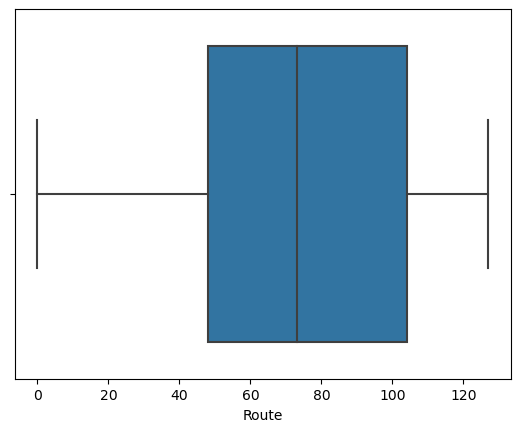

In [109]:
sns.boxplot(x=data['Route'])

<AxesSubplot:ylabel='Density'>

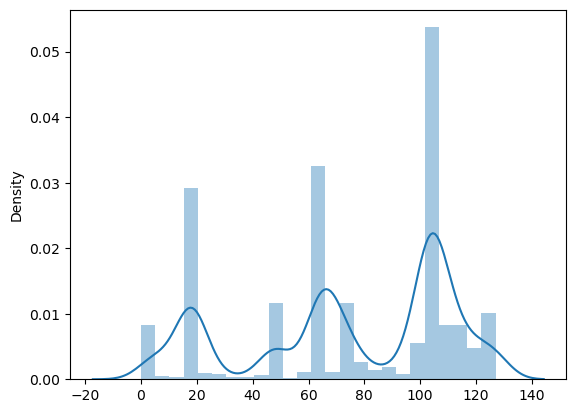

In [110]:
sns.distplot(x=data['Route'])

- No outliers in Route column

## Total_Stops

<AxesSubplot:xlabel='Total_Stops'>

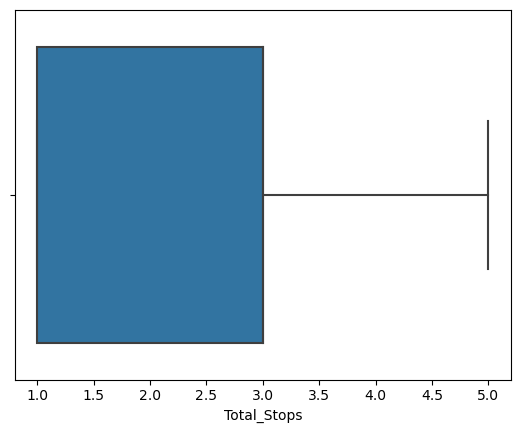

In [111]:
sns.boxplot(x=data['Total_Stops'])

<AxesSubplot:xlabel='Total_Stops', ylabel='Count'>

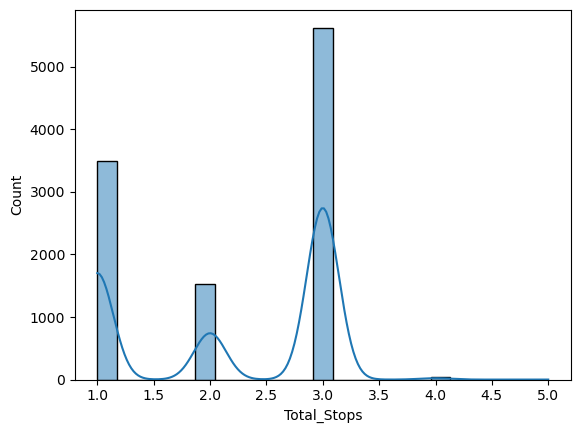

In [112]:
sns.histplot(x=data['Total_Stops'],kde=True)

- No outliers in Total_Stops column

## Additional_Info

<AxesSubplot:xlabel='Additional_Info'>

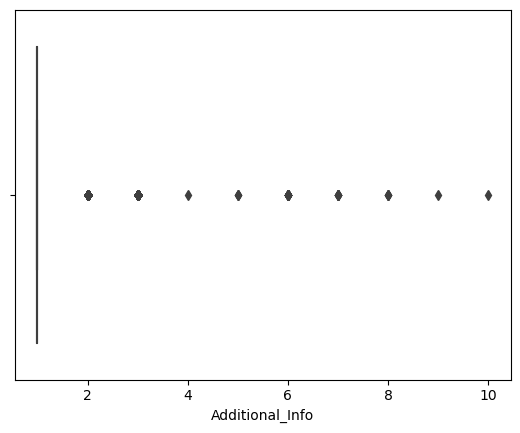

In [113]:
sns.boxplot(x=data['Additional_Info'])

<AxesSubplot:xlabel='Additional_Info', ylabel='Count'>

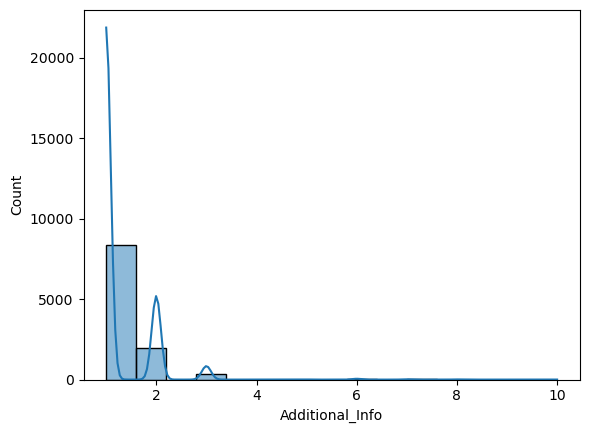

In [114]:
sns.histplot(x=data['Additional_Info'],kde=True)

In [115]:
# We replace the outliers in Additional_Info column with IQR
Q1 = data['Additional_Info'].quantile(0.25)
print('Q1: ',Q1)
Q3 = data['Additional_Info'].quantile(0.75)
print('Q3: ',Q3)
IQR = Q3-Q1
print('IQR :',IQR)
lower_limit = Q1-1.5*IQR
print('lower_limit: ',lower_limit)
upper_limit= Q3+1.5*IQR
print('upper_limit: ',upper_limit)

Q1:  1.0
Q3:  1.0
IQR : 0.0
lower_limit:  1.0
upper_limit:  1.0


In [116]:
data.loc[data['Additional_Info']<lower_limit]

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,month,day,dep_hour,dep_minute,Arrival_Time_hour,Arrival_Time_minute,Duration_hours,Duration_minutes


In [117]:
data.loc[data['Additional_Info']>upper_limit]

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,month,day,dep_hour,dep_minute,Arrival_Time_hour,Arrival_Time_minute,Duration_hours,Duration_minutes
6,3,1,1,5,3,2,11087,12,3,18,55,10,25,15,30
8,3,1,1,5,3,2,11087,12,3,8,55,10,25,1,30
13,3,2,2,66,3,2,9663,9,5,21,10,9,20,12,10
17,3,3,3,104,3,2,10262,12,6,14,0,12,35,22,35
19,3,3,3,104,3,2,12898,5,27,16,0,12,35,20,35
24,3,2,2,66,3,2,7757,6,5,18,55,8,15,13,20
33,3,3,3,122,2,2,10919,6,15,14,35,12,35,22,0
34,3,3,3,104,3,2,12373,5,18,7,5,12,35,5,30
42,3,3,3,104,3,2,12373,5,18,20,55,19,0,22,5
45,4,1,1,18,1,3,3527,3,24,5,45,8,35,2,50


In [118]:
data.loc[data['Additional_Info']>upper_limit].shape

(2338, 15)

In [119]:
(2338/10682)*100

21.887287024901703

- 21% outliers in Additional_info column so we are not imputing

## month

<AxesSubplot:xlabel='month'>

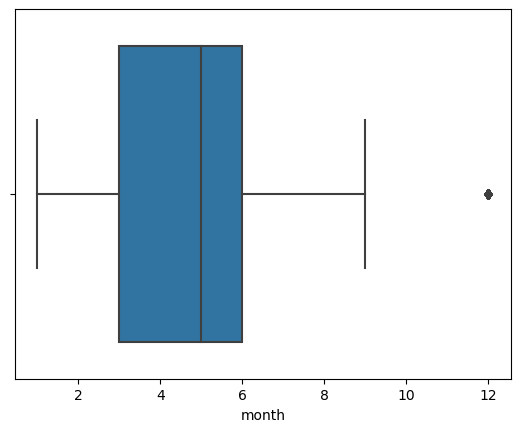

In [120]:
sns.boxplot(x=data['month'])

<AxesSubplot:ylabel='Density'>

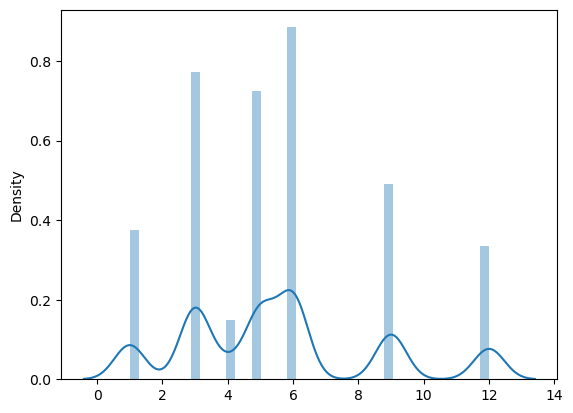

In [121]:
sns.distplot(x=data['month'],kde=True)

In [122]:
data.loc[data['month']<lower_limit]

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,month,day,dep_hour,dep_minute,Arrival_Time_hour,Arrival_Time_minute,Duration_hours,Duration_minutes


In [123]:
data.loc[data['month']>upper_limit]

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,month,day,dep_hour,dep_minute,Arrival_Time_hour,Arrival_Time_minute,Duration_hours,Duration_minutes
0,1,1,1,18,1,1,3897,3,24,22,20,1,10,2,50
2,3,3,3,118,2,1,13882,9,6,9,25,4,25,19,0
3,1,2,2,91,3,1,6218,12,5,18,5,23,30,5,25
5,4,2,2,64,1,1,3873,6,24,9,0,11,25,2,25
6,3,1,1,5,3,2,11087,12,3,18,55,10,25,15,30
8,3,1,1,5,3,2,11087,12,3,8,55,10,25,1,30
9,5,3,3,104,3,1,8625,5,27,11,25,19,15,7,50
11,1,2,2,64,1,1,4174,4,18,20,20,22,55,2,35
12,2,4,4,127,1,1,4667,6,24,11,40,13,55,2,15
13,3,2,2,66,3,2,9663,9,5,21,10,9,20,12,10


In [124]:
data.loc[data['month']>upper_limit].shape

(9607, 15)

In [125]:
(9607/10682)*100

89.93634150908069

- 89% outilers in month column

## day

<AxesSubplot:xlabel='day'>

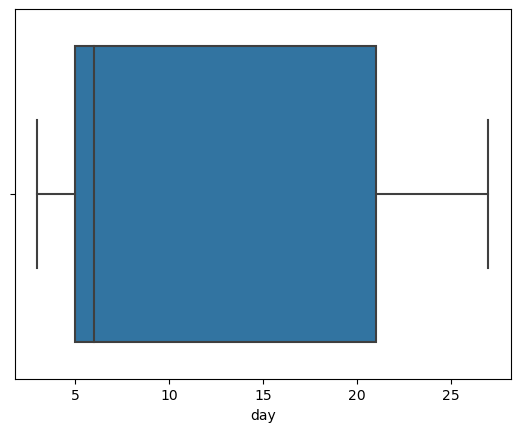

In [126]:
sns.boxplot(x=data['day'])

<AxesSubplot:ylabel='Density'>

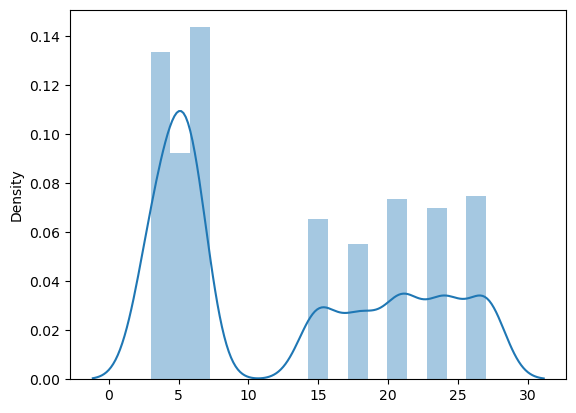

In [127]:
sns.distplot(x=data['day'],kde=True)

- no ouliers in day column

## dep_hour

<AxesSubplot:xlabel='dep_hour'>

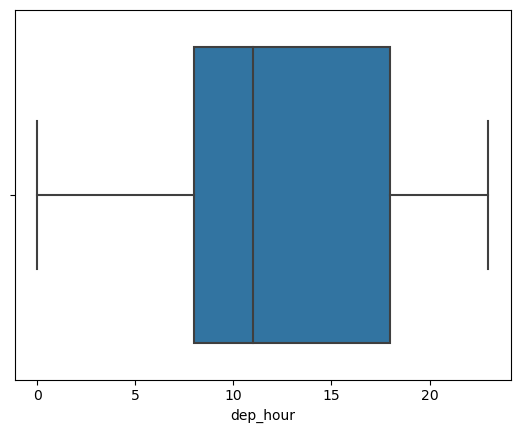

In [128]:
sns.boxplot(x=data['dep_hour'])

<AxesSubplot:ylabel='Density'>

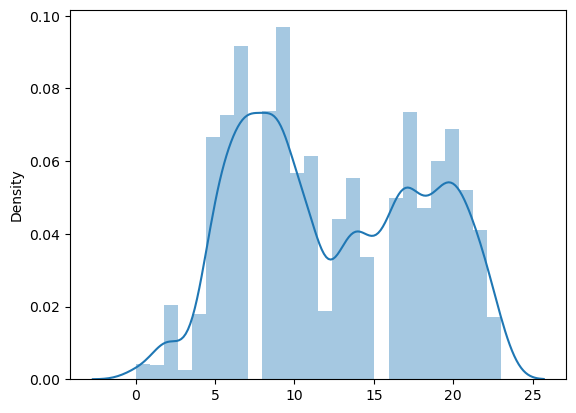

In [129]:
sns.distplot(x=data['dep_hour'],kde=True)

- no outliers in dep_hour column

## dep_minute

<AxesSubplot:xlabel='dep_minute'>

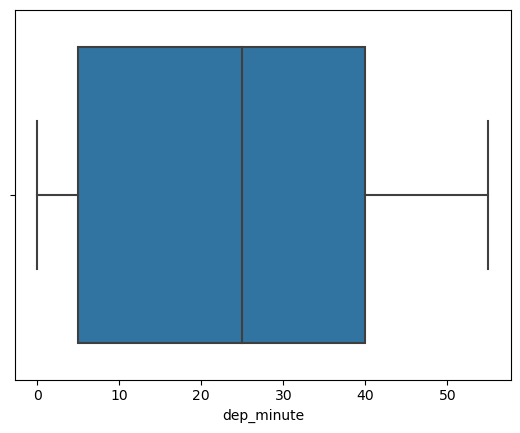

In [130]:
sns.boxplot(x=data['dep_minute'])

<AxesSubplot:ylabel='Density'>

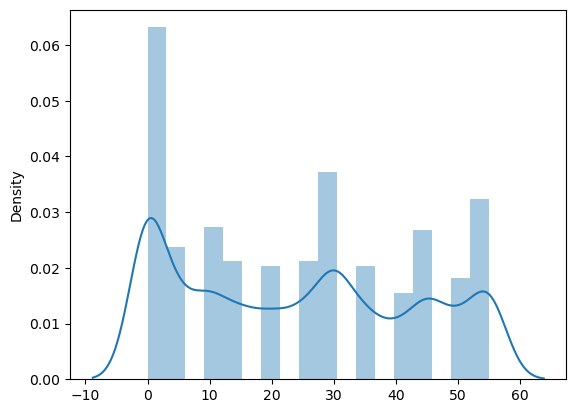

In [131]:
sns.distplot(x=data['dep_minute'],kde=True)

- No ouliers in dep_minute column

## Arrival_Time_hour

<AxesSubplot:xlabel='Arrival_Time_hour'>

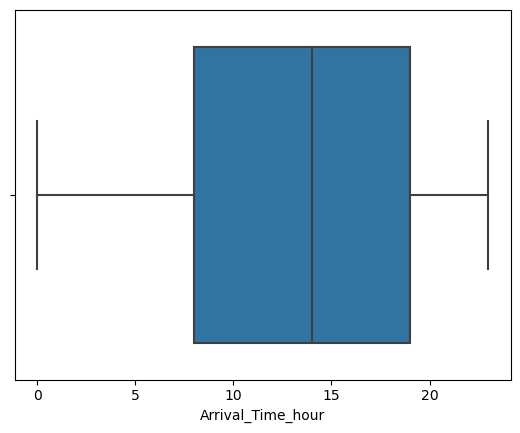

In [132]:
sns.boxplot(x=data['Arrival_Time_hour'])

<AxesSubplot:ylabel='Density'>

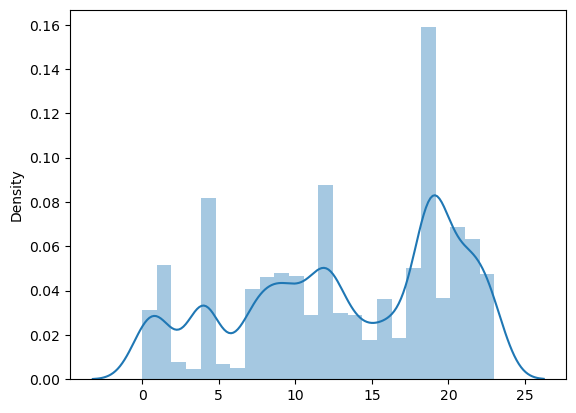

In [133]:
sns.distplot(x=data['Arrival_Time_hour'],kde=True)

- No ouliers in Arrival_Time_hour column

## Arrival_Time_hour

<AxesSubplot:xlabel='Arrival_Time_hour'>

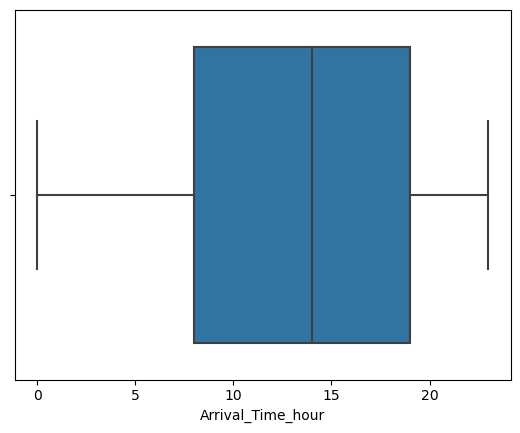

In [134]:
sns.boxplot(x=data['Arrival_Time_hour'])

<AxesSubplot:ylabel='Density'>

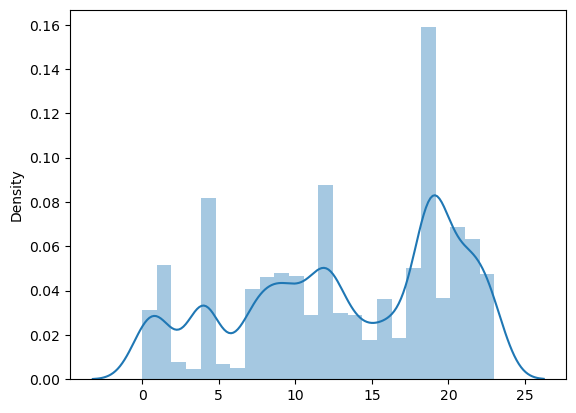

In [135]:
sns.distplot(x=data['Arrival_Time_hour'],kde=True)

- No outliers in Arrival_Time_hour column

## Arrival_Time_minute

<AxesSubplot:xlabel='Arrival_Time_minute'>

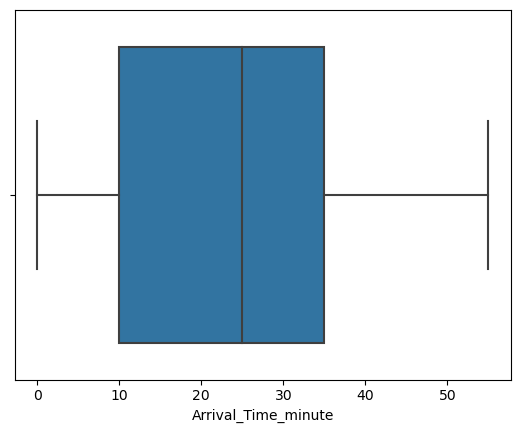

In [136]:
sns.boxplot(x=data['Arrival_Time_minute'])

<AxesSubplot:ylabel='Density'>

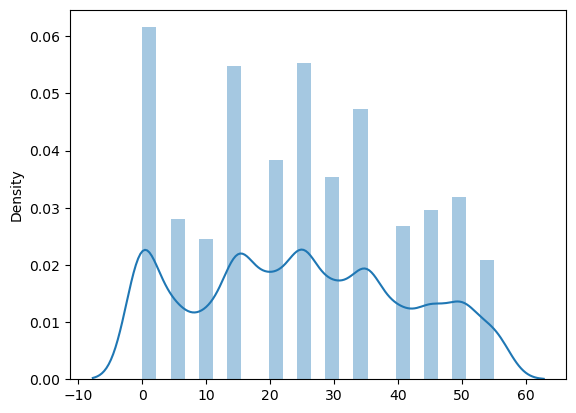

In [137]:
sns.distplot(x=data['Arrival_Time_minute'],kde=True)

- No ouliers in Arrival_time_minute_column

## Duration_hours

<AxesSubplot:xlabel='Duration_hours'>

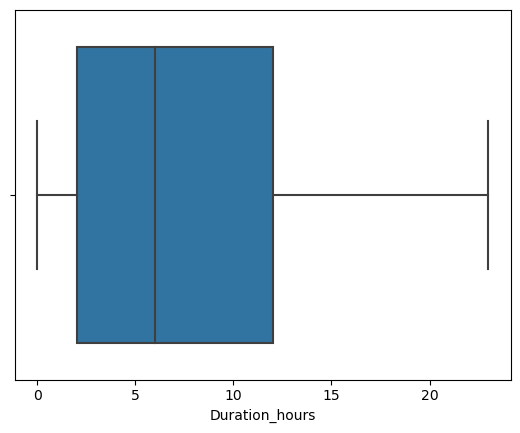

In [138]:
sns.boxplot(x=data['Duration_hours'])

<AxesSubplot:ylabel='Density'>

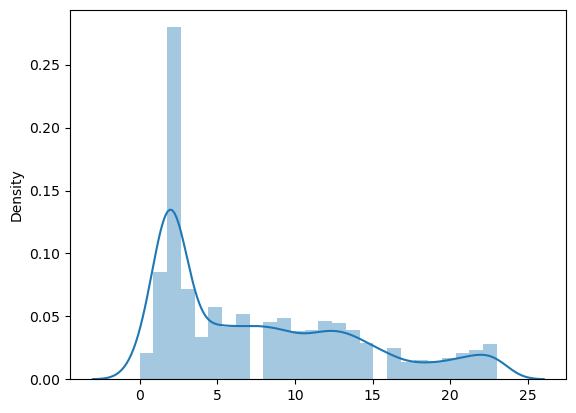

In [139]:
sns.distplot(x=data['Duration_hours'],kde=True)

- No ouliers in Duration_hours column

## Duration_minutes

<AxesSubplot:xlabel='Duration_minutes'>

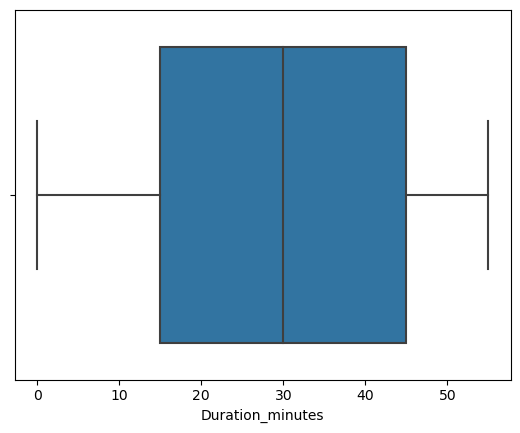

In [140]:
sns.boxplot(x=data['Duration_minutes'])

<AxesSubplot:ylabel='Density'>

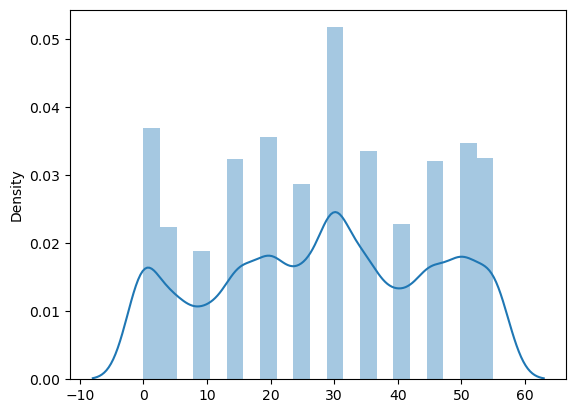

In [141]:
sns.distplot(x=data['Duration_minutes'],kde=True)

- No ouliers in Duration_minutes column

## Feature engineering

In [142]:
data.corr()

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,month,day,dep_hour,dep_minute,Arrival_Time_hour,Arrival_Time_minute,Duration_hours,Duration_minutes
Airline,1.000000,-0.008465,-0.014792,0.051757,0.158902,0.080552,0.122196,0.009421,0.019611,-0.039853,-0.032422,0.069805,-0.036856,0.063408,-0.055136
Source,-0.008465,1.000000,0.420846,0.621615,0.041888,-0.037979,-0.052764,0.011577,0.069854,-0.069650,-0.019541,-0.022452,-0.086469,0.027039,-0.207305
Destination,-0.014792,0.420846,1.000000,-0.093213,-0.503209,-0.039976,-0.395690,0.015181,0.065388,-0.050320,-0.005553,-0.054978,0.039328,-0.333417,0.044003
Route,0.051757,0.621615,-0.093213,1.000000,0.390819,-0.079765,0.164149,0.042194,0.096601,-0.075002,-0.068071,0.013898,-0.173352,0.294035,-0.232427
Total_Stops,0.158902,0.041888,-0.503209,0.390819,1.000000,0.021901,0.514278,0.049571,-0.048391,-0.039140,-0.057653,0.107950,-0.181985,0.532865,-0.182629
Additional_Info,0.080552,-0.037979,-0.039976,-0.079765,0.021901,1.000000,0.013490,-0.037100,0.013654,0.025706,0.056805,-0.058974,-0.029017,0.034746,-0.014926
Price,0.122196,-0.052764,-0.395690,0.164149,0.514278,0.013490,1.000000,0.010705,-0.165448,0.006799,-0.024458,0.024244,-0.086155,0.452643,-0.124855
month,0.009421,0.011577,0.015181,0.042194,0.049571,-0.037100,0.010705,1.000000,-0.264896,0.028189,0.002136,-0.004329,-0.025786,0.061320,-0.018597
day,0.019611,0.069854,0.065388,0.096601,-0.048391,0.013654,-0.165448,-0.264896,1.000000,-0.002301,-0.016433,-0.002176,-0.021423,-0.027581,-0.007708
dep_hour,-0.039853,-0.069650,-0.050320,-0.075002,-0.039140,0.025706,0.006799,0.028189,-0.002301,1.000000,-0.024745,0.005180,0.067911,0.011526,-0.023707


<AxesSubplot:>

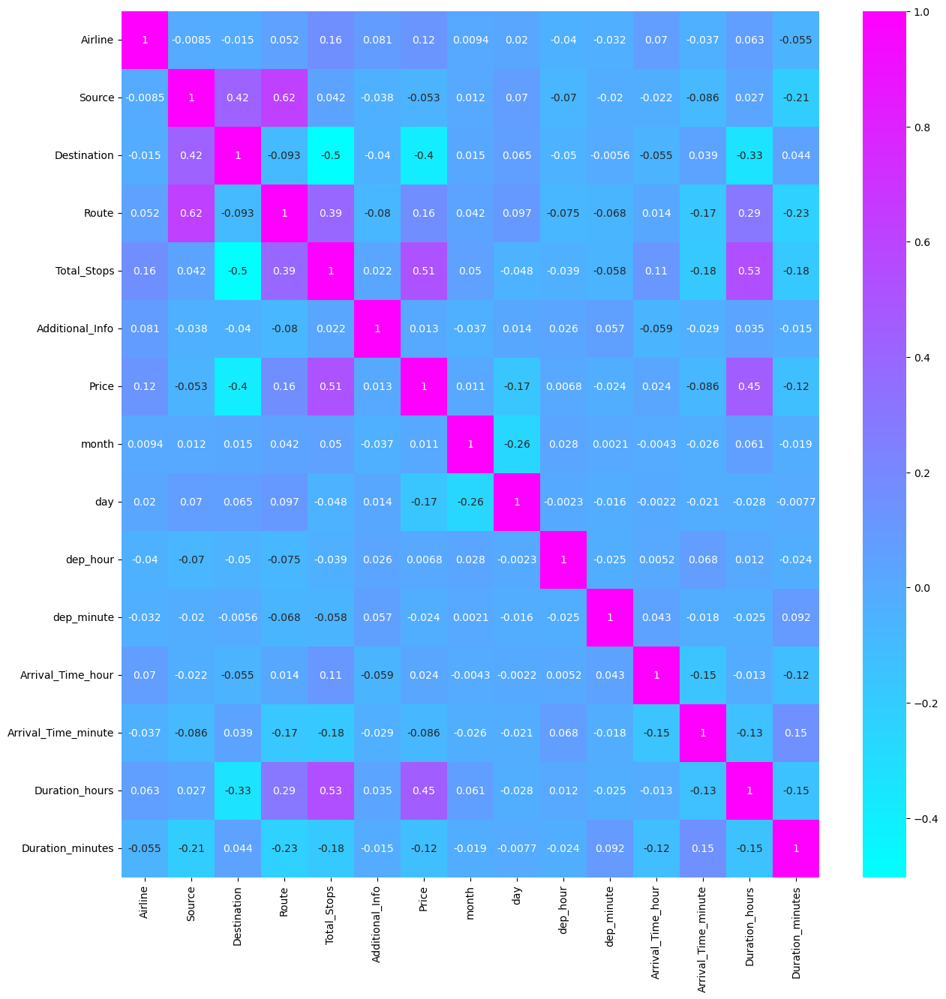

In [143]:
plt.figure(figsize=(15,15))
sns.heatmap(data.corr(),annot=True,cmap='cool')

## Model selection

In [144]:
x = data.drop('Price',axis=1)

In [145]:
y = data.Price

In [146]:
from sklearn.model_selection import train_test_split

In [147]:
x_train,x_test,y_train,y_test= train_test_split(x,y,test_size=0.20,random_state=2)

In [148]:
x_train.shape

(8545, 14)

In [149]:
x_test.shape

(2137, 14)

In [150]:
data.shape

(10682, 15)

## Model building

 - The output column is continous hence we can use regression algorithms

### Linear regression

In [151]:
from sklearn.linear_model import LinearRegression

In [152]:
lr= LinearRegression()

In [153]:
model_lr = lr.fit(x_train,y_train)

In [154]:
y_pred_lr_test = lr.predict(x_test)

In [155]:
y_pred_lr_train = lr.predict(x_train)

## Linear regression Evaluation

In [156]:
from sklearn.metrics import r2_score,mean_absolute_error,mean_squared_error

In [157]:
r2_score(y_test,y_pred_lr_test)

0.35028179105278545

In [158]:
r2_score(y_train,y_pred_lr_train)

0.357560278374502

In [159]:
mean_squared_error(y_test,y_pred_lr_test)

14451756.287045274

In [160]:
mean_absolute_error(y_test,y_pred_lr_test)

2711.8016846511264

In [161]:
mean_squared_error(y_train,y_pred_lr_train)

13499312.08397179

In [162]:
mean_absolute_error(y_train,y_pred_lr_train)

2653.6208559334505

- Linear regression has 35% accuracy for test data and 35% accuracy for train data
- Mean sqaured error for test data is 14451756.28 and 2711.8 for train_data
- Mean_absolute error for test data is 13499.08 and 2653.6 for train_data

## Knn Regressor

In [163]:
from sklearn.neighbors import KNeighborsRegressor

In [164]:
error_rate=[]

for i in range(1,11):
    model_knn = KNeighborsRegressor(n_neighbors=i)
    model_knn.fit(x_train,y_train)
    y_knn_predict = model_knn.predict(x_test)
    error_rate.append(np.mean(y_knn_predict!=y_test))
error_rate

[0.7356106691623772,
 0.8881609733270941,
 0.9475900795507721,
 0.9719232569021994,
 0.9798783341132429,
 0.9906410856340665,
 0.9962564342536265,
 0.9981282171268133,
 0.9990641085634067,
 0.9995320542817033]

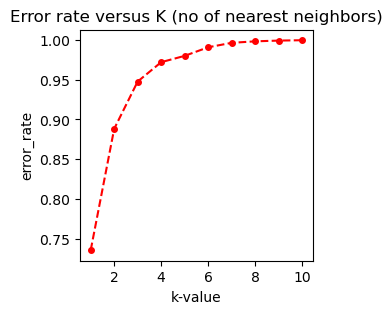

In [165]:
plt.figure(figsize=(3,3))
plt.plot(range(1,11),error_rate,color="red",linestyle="dashed",marker='o',markersize=4)
plt.title("Error rate versus K (no of nearest neighbors)")
plt.xlabel("k-value")
plt.ylabel("error_rate")
plt.show()

## When k =1 the error rate is less

- The data is in regression type hence we use Knn_regressor

In [166]:
model_knn = KNeighborsRegressor(n_neighbors=4)

In [167]:
model_knn.fit(x_train,y_train)

KNeighborsRegressor(n_neighbors=4)

In [168]:
y_pred_knn = model_knn.predict(x_test)

In [169]:
y_pred_knn_train = model_knn.predict(x_train)

In [170]:
r2_score(y_test,y_pred_knn)

0.6264904966839571

In [171]:
r2_score(y_train,y_pred_knn_train)

0.8003804573310023

- When applied k value from 1 through 10 the model is either overfitting or underfitting so we do not choose Knn model

## Support vector regressor

In [172]:
from sklearn.svm import SVR

In [173]:
model_svr= SVR()

In [174]:
model_svr.fit(x_train,y_train)

SVR()

In [175]:
y_pred_svr = model_svr.predict(x_train)

In [176]:
y_pred_svr_test = model_svr.predict(x_test)

In [177]:
r2_score(y_test,y_pred_svr_test)

-0.010437040533999742

In [178]:
r2_score(y_train,y_pred_svr)

0.011923192253973758

## Hyperparameter tuning for SVR

In [179]:
from sklearn.model_selection import GridSearchCV

In [180]:
params={'C':[2,5,10,15,20],'gamma':[1,0.1,0.001,0.0001,0.2]}

In [181]:
model_hyper_svr = GridSearchCV(model_svr,params,verbose=2,scoring='r2',cv=5)

In [182]:
model_hyper_svr.fit(x,y)

Fitting 5 folds for each of 25 candidates, totalling 125 fits
[CV] END .......................................C=2, gamma=1; total time=   4.8s
[CV] END .......................................C=2, gamma=1; total time=   4.9s
[CV] END .......................................C=2, gamma=1; total time=   4.9s
[CV] END .......................................C=2, gamma=1; total time=   4.9s
[CV] END .......................................C=2, gamma=1; total time=   4.9s
[CV] END .....................................C=2, gamma=0.1; total time=   4.1s
[CV] END .....................................C=2, gamma=0.1; total time=   4.1s
[CV] END .....................................C=2, gamma=0.1; total time=   4.1s
[CV] END .....................................C=2, gamma=0.1; total time=   4.2s
[CV] END .....................................C=2, gamma=0.1; total time=   4.4s
[CV] END ...................................C=2, gamma=0.001; total time=   3.3s
[CV] END ...................................C=2

[CV] END ......................................C=20, gamma=1; total time=   5.0s
[CV] END ......................................C=20, gamma=1; total time=   5.0s
[CV] END ......................................C=20, gamma=1; total time=   5.0s
[CV] END ......................................C=20, gamma=1; total time=   5.0s
[CV] END ....................................C=20, gamma=0.1; total time=   4.3s
[CV] END ....................................C=20, gamma=0.1; total time=   4.2s
[CV] END ....................................C=20, gamma=0.1; total time=   4.3s
[CV] END ....................................C=20, gamma=0.1; total time=   4.4s
[CV] END ....................................C=20, gamma=0.1; total time=   4.2s
[CV] END ..................................C=20, gamma=0.001; total time=   3.2s
[CV] END ..................................C=20, gamma=0.001; total time=   3.5s
[CV] END ..................................C=20, gamma=0.001; total time=   3.6s
[CV] END ...................

GridSearchCV(cv=5, estimator=SVR(),
             param_grid={'C': [2, 5, 10, 15, 20],
                         'gamma': [1, 0.1, 0.001, 0.0001, 0.2]},
             scoring='r2', verbose=2)

In [183]:
print(model_hyper_svr.best_params_)

{'C': 20, 'gamma': 0.001}


In [184]:
model_tune_hyper_svc= SVR(C=20,gamma=0.001)

In [185]:
model_tune_hyper_svc.fit(x_train,y_train)

SVR(C=20, gamma=0.001)

In [186]:
y_pred_model_tune_hyper_svr_test = model_tune_hyper_svc.predict(x_test)

In [187]:
y_pred_model_tune_hyper_svr_train = model_tune_hyper_svc.predict(x_train)

In [188]:
r2_score(y_test,y_pred_model_tune_hyper_svr_test)

0.15448560428020885

In [189]:
r2_score(y_train,y_pred_model_tune_hyper_svr_train)

0.202837581673461

## Desicion_Tree

In [190]:
from sklearn.tree import DecisionTreeRegressor

In [191]:
model_reg = DecisionTreeRegressor()

In [192]:
model_reg.fit(x_train,y_train)

DecisionTreeRegressor()

In [193]:
y_pred_train = model_reg.predict(x_train)

In [194]:
y_pred_test = model_reg.predict(x_test)

In [195]:
r2_score(y_test,y_pred_test)

0.8304399287447409

In [196]:
r2_score(y_train,y_pred_train)

0.9960369777077724

## Descision_Tree with hyperparameter

In [197]:
params = {
    "splitter":("best", "random"), 
    "max_depth":(list(range(1, 20))), 
    "min_samples_split":[2, 3, 4],    
    "min_samples_leaf":list(range(1, 20)),
}

In [198]:
model_hyper_dt = GridSearchCV(model_reg,params,verbose=2,scoring='r2',cv=5)

In [199]:
model_hyper_dt.fit(x_train,y_train)

Fitting 5 folds for each of 2166 candidates, totalling 10830 fits
[CV] END max_depth=1, min_samples_leaf=1, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=1, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=1, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=1, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=1, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=1, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=1, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=1, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=1, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=1, min_samples

[CV] END max_depth=1, min_samples_leaf=5, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=1

[CV] END max_depth=1, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=8, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=8, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=8, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=1

[CV] END max_depth=1, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=12, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=12, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=12, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=12, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=12, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=12, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=1, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=16, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=1, min_samples_leaf=19, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=19, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=19, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=19, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=19, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=19, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=19, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=19, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=19, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=19, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=2, min_samples_leaf=3, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=3, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=3, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=3, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=3, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=3, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=3, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=3, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=3, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=4, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=2

[CV] END max_depth=2, min_samples_leaf=6, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=6, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=6, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=6, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=6, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=6, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=6, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=6, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=6, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=6, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=2

[CV] END max_depth=2, min_samples_leaf=10, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=11, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=11, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=11, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=11, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=11, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=11, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=11, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=11, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=11, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=2, min_samples_leaf=13, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=13, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=13, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=13, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=13, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=13, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=14, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=14, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=14, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=14, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=2, min_samples_leaf=16, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=16, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=16, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=16, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=16, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=16, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=16, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=16, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=16, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=2, min_samples_leaf=16, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=3, min_samples_leaf=1, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=1, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=1, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=1, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=1, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=1, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=1, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=1, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=1, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=1, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=3

[CV] END max_depth=3, min_samples_leaf=5, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=5, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=5, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=5, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=3

[CV] END max_depth=3, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=8, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=8, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=3

[CV] END max_depth=3, min_samples_leaf=11, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=11, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=11, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=11, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=3, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=15, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=15, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=15, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=15, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=15, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=15, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=15, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=15, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=15, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=3, min_samples_leaf=18, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=18, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=18, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=18, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=18, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=18, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=18, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=18, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=18, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=3, min_samples_leaf=18, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=4, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=3, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=3, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=3, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=3, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=3, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=3, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=3, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=4

[CV] END max_depth=4, min_samples_leaf=5, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=5, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=5, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=5, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=5, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=6, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=6, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=6, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=6, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=6, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4

[CV] END max_depth=4, min_samples_leaf=8, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=8, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=8, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=8, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=8, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=8, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=8, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4

[CV] END max_depth=4, min_samples_leaf=11, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=11, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=4, min_samples_leaf=14, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=14, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=4, min_samples_leaf=17, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=17, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=17, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=17, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=17, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=17, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=4, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=5, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=5

[CV] END max_depth=5, min_samples_leaf=5, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=5, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=5, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=5, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=5, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=5, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=5, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=5, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=5, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=5, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=5

[CV] END max_depth=5, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=9, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=9, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=9, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=9, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=9, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=9, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=5

[CV] END max_depth=5, min_samples_leaf=12, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=12, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=12, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=12, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=12, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=12, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=12, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=12, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=12, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=12, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=5, min_samples_leaf=15, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=15, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=15, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=15, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=15, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=15, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=15, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=15, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=15, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=15, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=5, min_samples_leaf=18, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=18, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=18, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=18, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=18, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=19, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=19, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=19, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=19, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=5, min_samples_leaf=19, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=6, min_samples_leaf=2, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=2, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=2, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=2, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=2, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=6

[CV] END max_depth=6, min_samples_leaf=5, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=5, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=5, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=5, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=5, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=5, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=5, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=5, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=6, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=6, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=6

[CV] END max_depth=6, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=9, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=9, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=9, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=9, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=9, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=9, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=9, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=6

[CV] END max_depth=6, min_samples_leaf=12, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=12, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=12, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=12, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=12, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=12, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=12, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=12, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=12, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=12, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=6, min_samples_leaf=15, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=6, min_samples_leaf=19, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=19, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=19, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=19, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=19, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=19, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=19, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=19, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=19, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=6, min_samples_leaf=19, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=7, min_samples_leaf=3, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=3, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=3, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=3, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=3, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=3, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=3, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=3, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=3, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=3, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=7

[CV] END max_depth=7, min_samples_leaf=6, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=6, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=6, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=6, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=6, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=6, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=6, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=6, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=6, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=6, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=7

[CV] END max_depth=7, min_samples_leaf=9, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=9, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=9, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=9, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=9, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=9, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=9, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=9, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=9, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=10, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=

[CV] END max_depth=7, min_samples_leaf=12, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=12, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=12, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=12, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=12, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=13, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=13, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=13, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=13, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=13, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=7, min_samples_leaf=15, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=7, min_samples_leaf=18, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=18, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=18, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=18, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=18, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=18, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=18, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=18, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=18, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=7, min_samples_leaf=19, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=8, min_samples_leaf=2, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=2, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=2, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=3, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=3, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8

[CV] END max_depth=8, min_samples_leaf=5, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=5, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=5, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=5, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=5, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=5, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=5, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=6, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=6, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=6, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8

[CV] END max_depth=8, min_samples_leaf=8, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=8, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=8, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=8, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=9, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=8

[CV] END max_depth=8, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=12, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=12, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=12, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=8, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=15, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=15, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=15, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=15, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=8, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=18, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=18, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=18, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=18, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=18, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=8, min_samples_leaf=18, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=9, min_samples_leaf=1, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=1, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9

[CV] END max_depth=9, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=9

[CV] END max_depth=9, min_samples_leaf=8, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=8, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=8, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=8, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=9

[CV] END max_depth=9, min_samples_leaf=11, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=11, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=11, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=11, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=11, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=11, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=11, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=11, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=11, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=11, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=9, min_samples_leaf=14, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=14, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=9, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=18, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=18, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=18, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=18, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=18, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=9, min_samples_leaf=18, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=10, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=2, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=2, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=2, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=10, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=5, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=5, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=5, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=5, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=10, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=8, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=8, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=10, min_samples_leaf=11, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=11, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=11, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=11, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=11, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=11, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=11, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=11, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=11, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=11, min_samples_split=4, splitter=best; total time=   0.0s


[CV] END max_depth=10, min_samples_leaf=14, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=14, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s


[CV] END max_depth=10, min_samples_leaf=17, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=17, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=17, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=17, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=17, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=17, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=17, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=17, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=17, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=10, min_samples_leaf=17, min_samples_split=4, splitter=best; total time=   0.0s


[CV] END max_depth=11, min_samples_leaf=1, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=1, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=1, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=1, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=1, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=1, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=1, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=1, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=1, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=1, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=11, min_samples_leaf=4, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=4, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=4, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=4, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=4, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=4, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=4, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=4, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=4, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=4, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=11, min_samples_leaf=7, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=7, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=7, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=7, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=7, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=7, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=7, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=7, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=7, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=7, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=11, min_samples_leaf=10, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=10, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=10, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=10, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=10, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=10, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=10, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=10, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=10, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=10, min_samples_split=4, splitter=best; total time=   0.0s


[CV] END max_depth=11, min_samples_leaf=13, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=13, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=13, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=13, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=13, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=13, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=13, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=13, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=13, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=13, min_samples_split=4, splitter=random; total time=   0.0s


[CV] END max_depth=11, min_samples_leaf=16, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=16, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=16, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=16, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=16, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=16, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=16, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=16, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=16, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=16, min_samples_split=4, splitter=best; total time=   0.0s


[CV] END max_depth=11, min_samples_leaf=19, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=19, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=19, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=19, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=19, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=19, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=19, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=19, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=19, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=11, min_samples_leaf=19, min_samples_split=4, splitter=best; total time=   0.0s


[CV] END max_depth=12, min_samples_leaf=3, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=3, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=3, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=3, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=3, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=3, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=3, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=3, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=3, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=3, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=12, min_samples_leaf=6, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=6, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=6, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=6, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=6, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=6, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=6, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=6, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=6, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=6, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=12, min_samples_leaf=9, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=9, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=9, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=9, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=9, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=9, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=9, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=9, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=9, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=9, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=12, min_samples_leaf=12, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=12, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=13, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=13, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=13, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=13, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=13, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=13, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=13, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=13, min_samples_split=2, splitter=random; total time=   0.0s


[CV] END max_depth=12, min_samples_leaf=15, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=15, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=15, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=15, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=15, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s


[CV] END max_depth=12, min_samples_leaf=18, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=18, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=18, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=18, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=18, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=18, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=18, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=18, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=18, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=12, min_samples_leaf=18, min_samples_split=4, splitter=best; total time=   0.0s


[CV] END max_depth=13, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=2, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=2, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=2, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=2, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=2, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=2, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=13, min_samples_leaf=5, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=5, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=13, min_samples_leaf=8, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=8, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=8, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=13, min_samples_leaf=11, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=11, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=11, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=11, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=11, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=11, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=11, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=11, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=11, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=11, min_samples_split=4, splitter=best; total time=   0.0s


[CV] END max_depth=13, min_samples_leaf=14, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=14, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=14, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s


[CV] END max_depth=13, min_samples_leaf=17, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=17, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=17, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=17, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=17, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=17, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=17, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=17, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=17, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=13, min_samples_leaf=17, min_samples_split=4, splitter=best; total time=   0.0s


[CV] END max_depth=14, min_samples_leaf=1, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=1, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=1, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=1, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=1, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=1, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=1, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=1, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=1, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=1, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=14, min_samples_leaf=4, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=4, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=4, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=4, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=4, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=4, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=4, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=4, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=4, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=4, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=14, min_samples_leaf=7, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=7, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=7, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=7, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=7, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=7, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=7, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=7, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=7, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=7, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=14, min_samples_leaf=10, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=10, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=10, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=10, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=10, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=10, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=10, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=10, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=10, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=10, min_samples_split=3, splitter=best; total time=   0.0s


[CV] END max_depth=14, min_samples_leaf=13, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=13, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=13, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=13, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=13, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=13, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=13, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=13, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=13, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=13, min_samples_split=3, splitter=best; total time=   0.0s


[CV] END max_depth=14, min_samples_leaf=15, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=15, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s


[CV] END max_depth=14, min_samples_leaf=18, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=18, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=18, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=18, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=18, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=18, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=18, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=18, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=18, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=14, min_samples_leaf=18, min_samples_split=4, splitter=random; total time=   0.0s


[CV] END max_depth=15, min_samples_leaf=2, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=2, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=2, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=2, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=2, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=2, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=2, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=15, min_samples_leaf=5, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=5, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=5, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=5, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=5, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=5, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=5, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=5, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=5, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=5, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=15, min_samples_leaf=8, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=8, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=8, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=8, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=8, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=8, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=8, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=8, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=9, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=15, min_samples_leaf=11, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=11, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=11, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=11, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=12, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s


[CV] END max_depth=15, min_samples_leaf=14, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=14, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=14, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=14, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=14, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s


[CV] END max_depth=15, min_samples_leaf=17, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=17, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=17, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=17, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=17, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=17, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=17, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=17, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=17, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=15, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s


[CV] END max_depth=16, min_samples_leaf=1, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=1, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=1, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=1, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=1, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=1, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=1, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=16, min_samples_leaf=4, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=4, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=4, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=4, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=4, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=4, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=4, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=4, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=4, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=4, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=16, min_samples_leaf=7, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=7, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=7, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=7, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=7, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=7, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=7, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=8, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=8, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=8, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=16, min_samples_leaf=10, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=10, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=10, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=10, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=11, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=11, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=11, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=11, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=11, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=11, min_samples_split=2, splitter=random; total time=   0.0s


[CV] END max_depth=16, min_samples_leaf=14, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=14, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=14, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=14, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=14, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=14, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=14, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=14, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=14, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=14, min_samples_split=3, splitter=best; total time=   0.0s


[CV] END max_depth=16, min_samples_leaf=17, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=17, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=17, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=17, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=17, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=17, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=17, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=17, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=17, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=17, min_samples_split=3, splitter=best; total time=   0.0s


[CV] END max_depth=16, min_samples_leaf=19, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=19, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=16, min_samples_leaf=19, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=1, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=1, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=1, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=1, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=1, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=1, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=1, min_samples_split=2, splitter=random; total time=   0.0s
[CV] EN

[CV] END max_depth=17, min_samples_leaf=3, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=3, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=3, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=3, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=4, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=4, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=4, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=4, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=4, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=4, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=17, min_samples_leaf=6, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=6, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=6, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=6, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=6, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=6, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=7, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=7, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=7, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=7, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=17, min_samples_leaf=9, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=9, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=9, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=9, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=9, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=9, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=9, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=9, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=9, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=10, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END 

[CV] END max_depth=17, min_samples_leaf=12, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=12, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=12, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=12, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=12, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=12, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=12, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=13, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=13, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=13, min_samples_split=2, splitter=best; total time=   0.0s


[CV] END max_depth=17, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=16, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=16, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=16, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=16, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=16, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=16, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=16, min_samples_split=3, splitter=best; total time=   0.0s


[CV] END max_depth=17, min_samples_leaf=19, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=19, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=19, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=19, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=19, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=19, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=19, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=19, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=19, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=17, min_samples_leaf=19, min_samples_split=2, splitter=random; total time=   0.0s


[CV] END max_depth=18, min_samples_leaf=3, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=3, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=3, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=3, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=3, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=3, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=3, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=3, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=3, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=3, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=18, min_samples_leaf=6, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=6, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=6, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=6, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=6, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=6, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=6, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=6, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=6, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=6, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=18, min_samples_leaf=9, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=9, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=9, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=9, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=9, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=9, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=9, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=9, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=9, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=9, min_samples_split=3, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=18, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=12, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=12, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=12, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=12, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=12, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=12, min_samples_split=3, splitter=best; total time=   0.0s


[CV] END max_depth=18, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=15, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=15, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=15, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=15, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=15, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=15, min_samples_split=2, splitter=random; total time=   0.0s


[CV] END max_depth=18, min_samples_leaf=17, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=18, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=18, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=18, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=18, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=18, min_samples_leaf=18, min_samples_split=2, splitter=random; total time=   0.0s


[CV] END max_depth=19, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=2, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=2, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END m

[CV] END max_depth=19, min_samples_leaf=5, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=5, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=5, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=5, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=19, min_samples_leaf=8, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=8, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=8, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=8, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=8, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=8, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=8, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=8, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=8, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=8, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END m

[CV] END max_depth=19, min_samples_leaf=11, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=11, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=11, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=11, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=11, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=11, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=11, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=11, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=11, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=11, min_samples_split=2, splitter=random; total time=   0.0s


[CV] END max_depth=19, min_samples_leaf=14, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=14, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=14, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=14, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=14, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=14, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=14, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=14, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=14, min_samples_split=3, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=14, min_samples_split=3, splitter=best; total time=   0.0s


[CV] END max_depth=19, min_samples_leaf=16, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=17, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=17, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=17, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=17, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=17, min_samples_split=2, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=17, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=17, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=17, min_samples_split=2, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=17, min_samples_split=2, splitter=random; total time=   0.0s


[CV] END max_depth=19, min_samples_leaf=19, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=19, min_samples_split=4, splitter=best; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=19, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=19, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=19, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=19, min_samples_split=4, splitter=random; total time=   0.0s
[CV] END max_depth=19, min_samples_leaf=19, min_samples_split=4, splitter=random; total time=   0.0s


GridSearchCV(cv=5, estimator=DecisionTreeRegressor(),
             param_grid={'max_depth': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                       13, 14, 15, 16, 17, 18, 19],
                         'min_samples_leaf': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11,
                                              12, 13, 14, 15, 16, 17, 18, 19],
                         'min_samples_split': [2, 3, 4],
                         'splitter': ('best', 'random')},
             scoring='r2', verbose=2)

In [200]:
print(model_hyper_dt.best_params_)

{'max_depth': 17, 'min_samples_leaf': 8, 'min_samples_split': 2, 'splitter': 'best'}


In [201]:
model_reg_hyper_dt = DecisionTreeRegressor(max_depth=17,min_samples_leaf=8,min_samples_split=3,splitter='best')

In [202]:
model_reg_hyper_dt.fit(x_train,y_train)

DecisionTreeRegressor(max_depth=17, min_samples_leaf=8, min_samples_split=3)

In [203]:
y_pred_reg_hyper_dt_train = model_reg_hyper_dt.predict(x_train)

In [204]:
y_pred_reg_hyper_dt_test = model_reg_hyper_dt.predict(x_test)

In [205]:
r2_score(y_test,y_pred_reg_hyper_dt_test)

0.8299887726936834

In [206]:
r2_score(y_train,y_pred_reg_hyper_dt_train)

0.8854528035624064

## Random Forest Regressor

In [207]:
from sklearn.ensemble import RandomForestRegressor

In [208]:
model_random_reg = RandomForestRegressor()

In [209]:
model_random_reg.fit(x_train,y_train)

RandomForestRegressor()

In [210]:
y_pred_model_random_reg_train = model_random_reg.predict(x_train)

In [211]:
y_pred_model_random_reg_test = model_random_reg.predict(x_test)

In [212]:
r2_score(y_test,y_pred_model_random_reg_test)

0.8874185031720463

In [213]:
r2_score(y_train,y_pred_model_random_reg_train)

0.9807235342476971

## This model is overfit without applying hyperparameters

## Random Forest Regressor with Hyperparameters

In [214]:
params={
    'n_estimators': [int(x) for x in np.linspace(start=200, stop=1000, num=5)],
    'bootstrap':[True,False],
    'max_depth':[int(x) for x in np.linspace(10, 50, num=5)],
    'min_samples_split':[2,5],
    'min_samples_leaf':[1,2]
}

In [215]:
model_hyper_rf = GridSearchCV(model_random_reg,params,verbose=2.,scoring='r2',cv=3)

In [216]:
model_hyper_rf.fit(x_train,y_train)

Fitting 3 folds for each of 200 candidates, totalling 600 fits
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   1.6s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   1.6s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   1.5s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=400; total time=   3.0s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=400; total time=   3.2s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=400; total time=   3.2s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=600; total time=   4.8s
[CV] END bootstrap=True, max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=600; total time=   4.8s
[

[CV] END bootstrap=True, max_depth=20, min_samples_leaf=1, min_samples_split=2, n_estimators=800; total time=   8.8s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=1, min_samples_split=2, n_estimators=800; total time=   8.9s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=1, min_samples_split=2, n_estimators=1000; total time=  10.8s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=1, min_samples_split=2, n_estimators=1000; total time=  11.0s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=1, min_samples_split=2, n_estimators=1000; total time=  11.1s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   2.0s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   2.0s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   2.0s
[CV] END bootstrap=True, max_depth=20, min_samples_leaf=1, mi

[CV] END bootstrap=True, max_depth=30, min_samples_leaf=1, min_samples_split=5, n_estimators=400; total time=   4.1s
[CV] END bootstrap=True, max_depth=30, min_samples_leaf=1, min_samples_split=5, n_estimators=600; total time=   6.2s
[CV] END bootstrap=True, max_depth=30, min_samples_leaf=1, min_samples_split=5, n_estimators=600; total time=   6.1s
[CV] END bootstrap=True, max_depth=30, min_samples_leaf=1, min_samples_split=5, n_estimators=600; total time=   6.2s
[CV] END bootstrap=True, max_depth=30, min_samples_leaf=1, min_samples_split=5, n_estimators=800; total time=   8.2s
[CV] END bootstrap=True, max_depth=30, min_samples_leaf=1, min_samples_split=5, n_estimators=800; total time=   8.2s
[CV] END bootstrap=True, max_depth=30, min_samples_leaf=1, min_samples_split=5, n_estimators=800; total time=   8.5s
[CV] END bootstrap=True, max_depth=30, min_samples_leaf=1, min_samples_split=5, n_estimators=1000; total time=  10.0s
[CV] END bootstrap=True, max_depth=30, min_samples_leaf=1, min_

[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   2.1s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   2.1s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_samples_split=2, n_estimators=200; total time=   2.1s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_samples_split=2, n_estimators=400; total time=   4.1s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_samples_split=2, n_estimators=400; total time=   4.0s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_samples_split=2, n_estimators=400; total time=   4.6s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_samples_split=2, n_estimators=600; total time=   6.8s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_samples_split=2, n_estimators=600; total time=   6.6s
[CV] END bootstrap=True, max_depth=40, min_samples_leaf=2, min_s

[CV] END bootstrap=True, max_depth=50, min_samples_leaf=2, min_samples_split=2, n_estimators=800; total time=   8.7s
[CV] END bootstrap=True, max_depth=50, min_samples_leaf=2, min_samples_split=2, n_estimators=800; total time=   8.9s
[CV] END bootstrap=True, max_depth=50, min_samples_leaf=2, min_samples_split=2, n_estimators=1000; total time=  11.1s
[CV] END bootstrap=True, max_depth=50, min_samples_leaf=2, min_samples_split=2, n_estimators=1000; total time=  10.9s
[CV] END bootstrap=True, max_depth=50, min_samples_leaf=2, min_samples_split=2, n_estimators=1000; total time=  10.9s
[CV] END bootstrap=True, max_depth=50, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=   2.0s
[CV] END bootstrap=True, max_depth=50, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=   2.0s
[CV] END bootstrap=True, max_depth=50, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=   2.0s
[CV] END bootstrap=True, max_depth=50, min_samples_leaf=2, mi

[CV] END bootstrap=False, max_depth=10, min_samples_leaf=2, min_samples_split=5, n_estimators=400; total time=   4.8s
[CV] END bootstrap=False, max_depth=10, min_samples_leaf=2, min_samples_split=5, n_estimators=600; total time=   6.7s
[CV] END bootstrap=False, max_depth=10, min_samples_leaf=2, min_samples_split=5, n_estimators=600; total time=   6.6s
[CV] END bootstrap=False, max_depth=10, min_samples_leaf=2, min_samples_split=5, n_estimators=600; total time=   6.8s
[CV] END bootstrap=False, max_depth=10, min_samples_leaf=2, min_samples_split=5, n_estimators=800; total time=   9.1s
[CV] END bootstrap=False, max_depth=10, min_samples_leaf=2, min_samples_split=5, n_estimators=800; total time=   9.2s
[CV] END bootstrap=False, max_depth=10, min_samples_leaf=2, min_samples_split=5, n_estimators=800; total time=  10.1s
[CV] END bootstrap=False, max_depth=10, min_samples_leaf=2, min_samples_split=5, n_estimators=1000; total time=  11.6s
[CV] END bootstrap=False, max_depth=10, min_samples_lea

[CV] END bootstrap=False, max_depth=30, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   3.1s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   3.1s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time=   3.2s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=1, min_samples_split=2, n_estimators=400; total time=   6.2s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=1, min_samples_split=2, n_estimators=400; total time=   6.3s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=1, min_samples_split=2, n_estimators=400; total time=   6.5s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=1, min_samples_split=2, n_estimators=600; total time=   9.4s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf=1, min_samples_split=2, n_estimators=600; total time=   9.3s
[CV] END bootstrap=False, max_depth=30, min_samples_leaf

[CV] END bootstrap=False, max_depth=40, min_samples_leaf=1, min_samples_split=2, n_estimators=800; total time=  12.7s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=1, min_samples_split=2, n_estimators=800; total time=  13.6s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=1, min_samples_split=2, n_estimators=1000; total time=  16.4s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=1, min_samples_split=2, n_estimators=1000; total time=  16.4s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=1, min_samples_split=2, n_estimators=1000; total time=  16.8s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   2.8s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   2.8s
[CV] END bootstrap=False, max_depth=40, min_samples_leaf=1, min_samples_split=5, n_estimators=200; total time=   2.9s
[CV] END bootstrap=False, max_depth=40, min_samples_l

[CV] END bootstrap=False, max_depth=50, min_samples_leaf=1, min_samples_split=5, n_estimators=400; total time=   6.0s
[CV] END bootstrap=False, max_depth=50, min_samples_leaf=1, min_samples_split=5, n_estimators=600; total time=   8.7s
[CV] END bootstrap=False, max_depth=50, min_samples_leaf=1, min_samples_split=5, n_estimators=600; total time=   8.7s
[CV] END bootstrap=False, max_depth=50, min_samples_leaf=1, min_samples_split=5, n_estimators=600; total time=   9.7s
[CV] END bootstrap=False, max_depth=50, min_samples_leaf=1, min_samples_split=5, n_estimators=800; total time=  11.9s
[CV] END bootstrap=False, max_depth=50, min_samples_leaf=1, min_samples_split=5, n_estimators=800; total time=  11.8s
[CV] END bootstrap=False, max_depth=50, min_samples_leaf=1, min_samples_split=5, n_estimators=800; total time=  12.3s
[CV] END bootstrap=False, max_depth=50, min_samples_leaf=1, min_samples_split=5, n_estimators=1000; total time=  14.9s
[CV] END bootstrap=False, max_depth=50, min_samples_lea

GridSearchCV(cv=3, estimator=RandomForestRegressor(),
             param_grid={'bootstrap': [True, False],
                         'max_depth': [10, 20, 30, 40, 50],
                         'min_samples_leaf': [1, 2],
                         'min_samples_split': [2, 5],
                         'n_estimators': [200, 400, 600, 800, 1000]},
             scoring='r2', verbose=2.0)

In [217]:
print(model_hyper_rf.best_params_)

{'bootstrap': True, 'max_depth': 20, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 200}


In [218]:
model_random_reg_hyper = RandomForestRegressor(bootstrap=True,max_depth=20,min_samples_leaf=20,min_samples_split=2,n_estimators=200)

In [219]:
model_random_reg_hyper.fit(x_train,y_train)

RandomForestRegressor(max_depth=20, min_samples_leaf=20, n_estimators=200)

In [220]:
y_pred_model_random_reg_hyper_train = model_random_reg_hyper.predict(x_train)

In [221]:
y_pred_model_random_reg_hyper_test = model_random_reg_hyper.predict(x_test)

In [222]:
r2_score(y_test,y_pred_model_random_reg_hyper_test)

0.8176618839424844

In [223]:
r2_score(y_train,y_pred_model_random_reg_hyper_train)

0.8293668296632559

In [224]:
mean_squared_error(y_test,y_pred_model_random_reg_hyper_test)

4055767.529391004

In [225]:
mean_absolute_error(y_test,y_pred_model_random_reg_hyper_test)

1072.9839885746933

In [226]:
mean_squared_error(y_train,y_pred_model_random_reg_hyper_train)

3585442.0900767115

In [227]:
mean_absolute_error(y_train,y_pred_model_random_reg_hyper_train)

981.0096061285197

- Random forest has about 81% accuracy with train data and 82% accuracy with test data after applying hyperparameters
- it has a mean_absolute error of about 978
- This model has mean_squared_error of about 359


## Gradient boosting 

In [228]:
from sklearn.ensemble import GradientBoostingRegressor

In [229]:
model_gradient_reg= GradientBoostingRegressor()

In [230]:
model_gradient_reg.fit(x_train,y_train)

GradientBoostingRegressor()

In [231]:
y_pred_model_gradient_reg_test = model_gradient_reg.predict(x_test)

In [232]:
y_pred_model_gradient_reg_train = model_gradient_reg.predict(x_train)

In [233]:
r2_score(y_test,y_pred_model_gradient_reg_test)

0.8058943959060458

In [234]:
r2_score(y_train,y_pred_model_gradient_reg_train)

0.7960272598966056

In [235]:
mean_squared_error(y_test,y_pred_model_gradient_reg_test)

4317513.109046056

In [236]:
mean_absolute_error(y_train,y_pred_model_gradient_reg_train)

1356.3922650339803

## Gradient boosting with hyperparameters

In [237]:
param_grid = {
    'n_estimators': [50, 100, 150],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 4, 5],
    'min_samples_split': [2, 3, 4],
    'min_samples_leaf': [1, 2, 3]
}

In [238]:
gb_hyper = GridSearchCV(model_gradient_reg,param_grid,scoring='r2',verbose=2,cv=2)

In [239]:
gb_hyper.fit(x_train,y_train)

Fitting 2 folds for each of 243 candidates, totalling 486 fits
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=50; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=50; total time=   0.0s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=150; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=150; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=3, n_estimators=50; total time=   0.0s
[CV] END learning_rate=0.01, max_depth=3, min_samples_leaf=1, min_samples_split=3, n_estimators=50; 

[CV] END learning_rate=0.01, max_depth=4, min_samples_leaf=1, min_samples_split=4, n_estimators=100; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=4, min_samples_leaf=1, min_samples_split=4, n_estimators=100; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=4, min_samples_leaf=1, min_samples_split=4, n_estimators=150; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=4, min_samples_leaf=1, min_samples_split=4, n_estimators=150; total time=   0.4s
[CV] END learning_rate=0.01, max_depth=4, min_samples_leaf=2, min_samples_split=2, n_estimators=50; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=4, min_samples_leaf=2, min_samples_split=2, n_estimators=50; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=4, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=4, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=4, 

[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=3, n_estimators=150; total time=   0.6s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=4, n_estimators=50; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=4, n_estimators=50; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=4, n_estimators=100; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=4, n_estimators=100; total time=   0.3s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=4, n_estimators=150; total time=   0.6s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=2, min_samples_split=4, n_estimators=150; total time=   0.5s
[CV] END learning_rate=0.01, max_depth=5, min_samples_leaf=3, min_samples_split=2, n_estimators=50; total time=   0.1s
[CV] END learning_rate=0.01, max_depth=5, m

[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=3, min_samples_split=3, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=3, min_samples_split=3, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=3, min_samples_split=3, n_estimators=150; total time=   0.3s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=3, min_samples_split=3, n_estimators=150; total time=   0.3s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=3, min_samples_split=4, n_estimators=50; total time=   0.0s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=3, min_samples_split=4, n_estimators=50; total time=   0.0s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=3, min_samples_split=4, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=3, min_samples_leaf=3, min_samples_split=4, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.1, max_depth=3, min_sampl

[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=3, n_estimators=50; total time=   0.1s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=3, n_estimators=50; total time=   0.1s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=3, n_estimators=100; total time=   0.3s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=3, n_estimators=100; total time=   0.4s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=3, n_estimators=150; total time=   0.6s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=3, n_estimators=150; total time=   0.6s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=4, n_estimators=50; total time=   0.1s
[CV] END learning_rate=0.1, max_depth=5, min_samples_leaf=1, min_samples_split=4, n_estimators=50; total time=   0.1s
[CV] END learning_rate=0.1, max_depth=5, min_samples

[CV] END learning_rate=0.2, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=150; total time=   0.3s
[CV] END learning_rate=0.2, max_depth=3, min_samples_leaf=2, min_samples_split=2, n_estimators=150; total time=   0.3s
[CV] END learning_rate=0.2, max_depth=3, min_samples_leaf=2, min_samples_split=3, n_estimators=50; total time=   0.0s
[CV] END learning_rate=0.2, max_depth=3, min_samples_leaf=2, min_samples_split=3, n_estimators=50; total time=   0.0s
[CV] END learning_rate=0.2, max_depth=3, min_samples_leaf=2, min_samples_split=3, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.2, max_depth=3, min_samples_leaf=2, min_samples_split=3, n_estimators=100; total time=   0.2s
[CV] END learning_rate=0.2, max_depth=3, min_samples_leaf=2, min_samples_split=3, n_estimators=150; total time=   0.3s
[CV] END learning_rate=0.2, max_depth=3, min_samples_leaf=2, min_samples_split=3, n_estimators=150; total time=   0.3s
[CV] END learning_rate=0.2, max_depth=3, min_sampl

[CV] END learning_rate=0.2, max_depth=4, min_samples_leaf=3, min_samples_split=2, n_estimators=100; total time=   0.3s
[CV] END learning_rate=0.2, max_depth=4, min_samples_leaf=3, min_samples_split=2, n_estimators=100; total time=   0.3s
[CV] END learning_rate=0.2, max_depth=4, min_samples_leaf=3, min_samples_split=2, n_estimators=150; total time=   0.5s
[CV] END learning_rate=0.2, max_depth=4, min_samples_leaf=3, min_samples_split=2, n_estimators=150; total time=   0.5s
[CV] END learning_rate=0.2, max_depth=4, min_samples_leaf=3, min_samples_split=3, n_estimators=50; total time=   0.1s
[CV] END learning_rate=0.2, max_depth=4, min_samples_leaf=3, min_samples_split=3, n_estimators=50; total time=   0.1s
[CV] END learning_rate=0.2, max_depth=4, min_samples_leaf=3, min_samples_split=3, n_estimators=100; total time=   0.3s
[CV] END learning_rate=0.2, max_depth=4, min_samples_leaf=3, min_samples_split=3, n_estimators=100; total time=   0.3s
[CV] END learning_rate=0.2, max_depth=4, min_sampl

GridSearchCV(cv=2, estimator=GradientBoostingRegressor(),
             param_grid={'learning_rate': [0.01, 0.1, 0.2],
                         'max_depth': [3, 4, 5], 'min_samples_leaf': [1, 2, 3],
                         'min_samples_split': [2, 3, 4],
                         'n_estimators': [50, 100, 150]},
             scoring='r2', verbose=2)

In [240]:
print(gb_hyper.best_params_)

{'learning_rate': 0.2, 'max_depth': 5, 'min_samples_leaf': 3, 'min_samples_split': 4, 'n_estimators': 150}


In [241]:
model_gradient_reg_hyper = GradientBoostingRegressor(learning_rate=0.2,max_depth=5,min_samples_leaf=3,min_samples_split=3,n_estimators=150)

In [242]:
model_gradient_reg_hyper.fit(x_train,y_train)

GradientBoostingRegressor(learning_rate=0.2, max_depth=5, min_samples_leaf=3,
                          min_samples_split=3, n_estimators=150)

In [243]:
y_pred_model_gradient_reg_hyper_test = model_gradient_reg_hyper.predict(x_test)

In [244]:
y_pred_model_gradient_reg_hyper_train = model_gradient_reg_hyper.predict(x_train)

In [245]:
r2_score(y_test,y_pred_model_gradient_reg_hyper_test)

0.8950144475788531

In [246]:
r2_score(y_train,y_pred_model_gradient_reg_hyper_train)

0.9509201072213115

In [247]:
mean_squared_error(y_test,y_pred_model_gradient_reg_hyper_test)

2335205.6266203504

In [248]:
mean_squared_error(y_train,y_pred_model_gradient_reg_hyper_train)

1031294.8707328095

In [249]:
mean_absolute_error(y_test,y_pred_model_gradient_reg_hyper_test)

833.2847071828403

In [250]:
mean_absolute_error(y_train,y_pred_model_gradient_reg_hyper_train)

651.0715275761312

## After hyperparameter tuning with GradinetBoost:
- we have accuracy of gradient boosting upto 89% with test data and 95% accuracy with train data
- mean_squred error is 2327.7 for test data and 1031.8 for train data
- mean_absolute_error is 832.5 for test data and 651.7 for train data

## XGBoost

In [251]:
from xgboost import XGBRegressor

In [252]:
xgb_reg_model = XGBRegressor()

In [253]:
xgb_reg_model.fit(x_train,y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...)

In [254]:
y_pred_xgb_reg_model_train = xgb_reg_model.predict(x_train)

In [255]:
y_pred_xgb_reg_model_test = xgb_reg_model.predict(x_test)

In [256]:
r2_score(y_test,y_pred_xgb_reg_model_test)

0.899260077343556

In [257]:
r2_score(y_train,y_pred_xgb_reg_model_train)

0.9741933221011195

In [258]:
mean_squared_error(y_train,y_pred_xgb_reg_model_train)

542264.7247372477

In [259]:
mean_absolute_error(y_test,y_pred_xgb_reg_model_test)

740.5597984017643

## Hyperparameter tuning with XGBoosting

In [260]:
param_grid = {'gamma': [0,0.1,0.2,0.4,0.8],
              'learning_rate': [0.01, 0.03, 0.06, 0.1],
              'max_depth': [5,6,7,8,9],
              'n_estimators': [50,65,80,100,110],
              'reg_alpha': [0,0.1,0.2,0.4,0.8],
              'reg_lambda': [0,0.1,0.2,0.4,0.8]}

In [261]:
xgb_reg_model_hyper = GridSearchCV(xgb_reg_model,param_grid,verbose=2,cv=3)

In [262]:
xgb_reg_model_hyper.fit(x_train,y_train)

Fitting 3 folds for each of 12500 candidates, totalling 37500 fits
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END ga

[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=65, reg_al

[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=80, 

[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_est

[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=

[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=5, n_e

[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimat

[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_est

[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimator

[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_e

[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=

[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimator

[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimator

[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_est

[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=7,

[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=7, n_estimat

[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=50, reg_

[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=65, reg_

[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alph

[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimator

[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=

[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=8, n_e

[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimator

[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_est

[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimat

[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_e

[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0, learning_rate=0.01, max_depth=

[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimat

[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimator

[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estim

[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=

[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=5, n_estim

[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=50, reg_

[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=65, reg_

[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=80, reg_

[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=100,

[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n

[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=

[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimator

[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimat

[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_est

[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_e

[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=7, n_e

[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_est

[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estim

[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimator

[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=8,

[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=

[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=50

[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=65, reg_

[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=80, reg_

[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=100,

[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.3s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n

[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.03, max_depth=

[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimator

[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimat

[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_est

[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_e

[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=5, n

[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_est

[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimat

[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimator

[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=

[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=6, n

[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=50, re

[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=65, reg_

[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=80, reg_al

[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=100

[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=

[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=7,

[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimator

[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_est

[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_est

[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_e

[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=8, n

[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_est

[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimator

[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimator

[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.3s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.3s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0, learning_rate=0.06, max_depth=

[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.3s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.3s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.3s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.3s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.3s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.3s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.3s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.3s
[CV] END gamma=0, learning_rate=0.06, max_depth=9, n_e

[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0

[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.1

[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, 

[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=100, reg_al

[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=110, reg_al

[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimator

[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=5

[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=65, reg

[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=80, reg

[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimato

[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=6, n_esti

[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=5

[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=65, reg

[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=80, reg

[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estima

[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=7, n_esti

[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=50, r

[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=65, reg

[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=80, reg

[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_esti

[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=8, n_estimato

[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0

[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.1

[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, 

[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.3s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=

[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.3s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.3s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=110, 

[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.3s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0, learning_rate=0.1, max_depth=9, n_esti

[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, ma

[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_de

[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, 

[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.

[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01

[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, 

[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_de

[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_de

[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rat

[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, 

[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_e

[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_est

[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_e

[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, 

[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.

[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01

[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, 

[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_de

[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_de

[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rat

[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01

[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, ma

[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, ma

[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n

[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.01, max_dept

[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9,

[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.3s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.3s
[CV] END gamma=0.1, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.0

[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, 

[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_de

[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, 

[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=

[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03

[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, ma

[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, 

[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_de

[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=

[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rat

[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7,

[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_e

[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estim

[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=

[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rat

[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03

[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_de

[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, 

[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_de

[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.

[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rat

[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_de

[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, 

[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.03, max_

[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_dept

[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.3s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_dept

[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_e

[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5,

[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, 

[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_de

[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06

[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rat

[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_de

[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_

[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, 

[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06

[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=

[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, 

[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_dept

[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_e

[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_dept

[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7,

[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, ma

[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.06, 

[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_de

[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, ma

[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=

[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.3s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.4s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.3s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06

[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.06, 

[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_de

[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.3s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.3s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.1, learning_rate=0.06, ma

[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.4s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.4s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.4s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.4s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.4s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.4s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.3s
[CV] END gamma=0.1, learning_rate=

[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.4; total time=   0.5s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.4s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.4s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.5s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.5s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.5s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.4s
[CV] END gamma=0.1, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.4s
[CV] END gamma=0.1, learning_rate=0.06, max_de

[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators

[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=65,

[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimato

[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth

[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_dep

[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_d

[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth

[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_

[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, 

[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, m

[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_dep

[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7

[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth

[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_esti

[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_es

[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_es

[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators

[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, 

[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth

[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_

[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_d

[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, m

[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_

[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, 

[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.3s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.1, learning_rate=0.1, max_depth

[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_dep

[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.1, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.1, learning_rate=0.1, max

[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, 

[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_dept

[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_e

[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_dept

[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n

[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, ma

[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, 

[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_de

[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, 

[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=

[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01

[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, ma

[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, 

[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_de

[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rat

[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=

[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n

[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_e

[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estim

[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_de

[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rat

[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01

[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.01, 

[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_de

[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01, max_

[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.2, learning_rat

[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.3s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.4s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.3s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.4s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.4s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.3s
[CV] END gamma=0.2, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.01

[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, 

[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_

[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_e

[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_dept

[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5,

[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, ma

[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, 

[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_de

[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, 

[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=

[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03

[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, 

[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_de

[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_

[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rat

[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, ma

[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_e

[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_e

[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_e

[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, 

[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03

[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.

[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.03, 

[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_de

[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.03, 

[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.3s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.3s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.3s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.3s
[CV] END gamma=0.2, learning_rate=0.

[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.2, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.4s
[CV] END gamma=0.2, learning_rate=0.03

[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, 

[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=

[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_e

[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=

[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_dept

[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rat

[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_

[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_de

[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, 

[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06

[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06

[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, 

[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_

[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_de

[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rat

[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06

[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_e

[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_e

[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_e

[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, 

[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.

[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06

[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.06, 

[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_de

[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, 

[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.

[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.06

[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth

[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_

[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimato

[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_es

[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estima

[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_esti

[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth

[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, 

[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_

[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, m

[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_dep

[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_

[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth

[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_

[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_dep

[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, m

[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_

[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators

[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators

[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimato

[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth

[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, m

[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_

[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_

[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.2, learning_rate=0.1, max_depth

[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_dep

[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.3s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.2, learning_rate=0.1, max

[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, 

[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_de

[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_

[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rat

[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, 

[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_e

[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_est

[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_e

[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, 

[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.

[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01

[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, 

[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_

[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_de

[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rat

[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01

[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, ma

[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, 

[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8,

[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_dept

[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n

[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, ma

[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.01, 

[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_de

[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.01, ma

[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=

[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.01

[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, 

[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_de

[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, ma

[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=

[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_

[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_e

[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estim

[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n

[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, 

[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.

[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03

[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, 

[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_de

[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_de

[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rat

[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03

[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_

[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, 

[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8,

[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_dept

[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n

[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, ma

[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, 

[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_de

[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.3s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.03, 

[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.4s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.3s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.3s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.3s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.3s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.3s
[CV] END gamma=0.4, learning_rate=0.03

[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.3s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.4s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.4s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.3s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.3s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.3s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.4s
[CV] END gamma=0.4, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.4, learning_rate=0.

[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, 

[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_de

[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, ma

[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rat

[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, ma

[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_e

[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estim

[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6,

[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, 

[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06

[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.

[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, 

[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_de

[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_

[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rat

[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06

[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, ma

[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, ma

[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8,

[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_dept

[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n

[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, ma

[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.06, 

[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_de

[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.06, 

[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.

[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.06

[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth

[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_

[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_

[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, m

[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max

[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estima

[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators

[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators

[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimat

[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth

[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, m

[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, 

[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_

[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth

[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_d

[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_dep

[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth

[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, 

[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_

[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, m

[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_dep

[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators

[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators

[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=80, r

[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_est

[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, m

[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.4, learning_rate=0.1, max_dep

[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_de

[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, 

[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_de

[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01

[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rat

[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_

[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_de

[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, 

[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01

[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_dept

[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_e

[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimat

[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7,

[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, 

[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01

[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.

[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, 

[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_de

[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, 

[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.

[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01

[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.01, 

[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=

[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_e

[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.3s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9,

[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_

[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.01, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rat

[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_de

[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_

[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, 

[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03

[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03

[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, 

[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_de

[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_

[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rat

[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, 

[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_e

[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_e

[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_est

[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max

[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rat

[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03

[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, 

[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_

[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_de

[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rat

[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03

[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, ma

[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, ma

[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9,

[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=100, reg_alpha=0, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_dept

[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n

[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.03, max_depth=9, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, ma

[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=50, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, 

[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_de

[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_de

[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=100, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rat

[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06

[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_de

[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=65, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, 

[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=80, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_de

[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.

[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=6, n_estimators=110, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rat

[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=50, reg_alpha=0.1, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_de

[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_e

[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=80, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_e

[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n

[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=100, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_

[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=7, n_estimators=110, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rat

[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_de

[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_

[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=80, reg_alpha=0.4, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, 

[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06

[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=

[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=50, reg_alpha=0.2, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.06, 

[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_de

[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.06, 

[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.

[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.06, max_dept

[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=50, reg_alpha=0, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators

[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=6

[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=80,

[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_

[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=100, reg_alpha=0.8, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, m

[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=5, n_estimators=110, reg_alpha=0.8, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_dep

[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=50, reg_alpha=0.8, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_

[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=65, reg_alpha=0.4, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth

[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=80, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, 

[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=100, reg_alpha=0.4, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_dep

[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=6, n_estimators=110, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, m

[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=50, reg_alpha=0.2, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, 

[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=65, reg_alpha=0.2, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_

[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=80, reg_alpha=0.1, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth

[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=100, reg_alpha=0.1, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_d

[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_estimators=110, reg_alpha=0.1, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=7, n_es

[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.1; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators

[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=50, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=65,

[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=65, reg_alpha=0.8, reg_lambda=0.8; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_es

[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=80, reg_alpha=0.8, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth

[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=100, reg_alpha=0.8, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_dep

[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.4, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=8, n_estimators=110, reg_alpha=0.8, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max

[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.2; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=50, reg_alpha=0.4, reg_lambda=0.4; total time=   0.0s
[CV] END gamma=0.8, learning_rate=0.1, max_depth

[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.1; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=65, reg_alpha=0.4, reg_lambda=0.2; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_

[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.4; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.2, reg_lambda=0.8; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=80, reg_alpha=0.4, reg_lambda=0; total time=   0.1s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_

[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.3s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.4; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=100, reg_alpha=0.2, reg_lambda=0.8; total time=   0.3s
[CV] END gamma=0.8, learning_rate=0.1, m

[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.1, reg_lambda=0.8; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.3s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.3s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.1; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_depth=9, n_estimators=110, reg_alpha=0.2, reg_lambda=0.2; total time=   0.2s
[CV] END gamma=0.8, learning_rate=0.1, max_dep

GridSearchCV(cv=3,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    callbacks=None, colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None,
                                    early_stopping_rounds=None,
                                    enable_categorical=False, eval_metric=None,
                                    feature_types=None, gamma=None, gpu_id=None,
                                    grow_policy=None, importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None, m...
                                    min_child_weight=None, missing=nan,
                                    monotone_constraints=None, n_estimators=100,
                                    n_jobs=None, num_parallel_tree=None,
                                    predictor=None, random_state=N

In [267]:
print(xgb_reg_model_hyper.best_params_)

{'gamma': 0, 'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 110, 'reg_alpha': 0.8, 'reg_lambda': 0.8}


In [268]:
xgb_reg_model_hyper = XGBRegressor(gamma=0,learning_rate=0.1,max_depth=7,n_estimators=110,reg_alpha=0.8,reg_lambda=0.8)

In [269]:
xgb_reg_model_hyper.fit(x_train,y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=0, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=7, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=110, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...)

In [270]:
y_pred_xgb_hyper_test = xgb_reg_model_hyper.predict(x_test)

In [271]:
y_pred_xgb_hyper_train = xgb_reg_model_hyper.predict(x_train)

In [273]:
r2_score(y_test,y_pred_xgb_hyper_test)

0.8896510230370428

In [274]:
r2_score(y_train,y_pred_xgb_hyper_train)

0.9634057310092076

In [275]:
mean_squared_error(y_test,y_pred_xgb_hyper_test)

2454504.8909395626

In [276]:
mean_absolute_error(y_train,y_pred_xgb_hyper_train)

560.3347019255824

- The model is overfit after applying Hyperparameters
- Hence we do not consider this model

## Conclusion

- 35% accuracy on appyling linear regression
- 62% accuracy on applying K-nearest neighbour algorithm
- 15% accuracy on applying Support vector regressor
- 81% accuracy on applying random forest regressor
- 82%  accuracy on applying descision tree algorithm
- 89% accuracy on applying XGboosting algorithm
- 89% accuracy on applying GradientBoosting algorithm

- Thus we conculde RandomForest,XGBoosting and GradientBoosting are the best algorithms For this problem
- We conclude RandomForest is the Best algorithm as there is only tiny variation of accuracy between train and test datas